In [1]:
# Nativos
import os
import sys

#calculo
import numpy as np
import pandas as pd
from IPython.display import display

#grafico
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set(style="whitegrid")

#warning ignore future
import warnings
warnings.filterwarnings('ignore')

from extract import Extract

# **CARGA DE DATA**

In [2]:
df_global = pd.read_csv(
    'all_peru21.csv', parse_dates=['Fecha']
)
df_global.index = df_global['Fecha']
df_global['weekday'] = df_global['Fecha'].dt.weekday
df_global = df_global.sort_index()

del df_global.index.name
df_global.head()

,Producto,Fecha,CodigoSapAgencia,NombreAgencia,CodigoSapCanilla,NombreCanilla,Pauta,Devolucion,VentaNeta,Lim. Inf Vta. Proy,Vta. Proy,Lim. Sup Vta. Proy,weekday
2018-01-01,Peru 21,2018-01-01,1200000065,CALLAO,1300000005,ABANTO LECCA LIDIA,2,2,0,NaN,NaN,NaN,0
2018-01-01,Peru 21,2018-01-01,1200000077,LOS OLIVOS,1300005097,PALOMINO RAMIREZ DIANA,0,0,0,NaN,NaN,NaN,0
2018-01-01,Peru 21,2018-01-01,1200000077,LOS OLIVOS,1300004633,MORENO ALVA MARIA ANASTACIA,10,1,9,NaN,NaN,NaN,0
2018-01-01,Peru 21,2018-01-01,1200000077,LOS OLIVOS,1300004632,MORENO ALVA JULIO,10,2,8,NaN,NaN,NaN,0
2018-01-01,Peru 21,2018-01-01,1200000077,LOS OLIVOS,1300004628,MORALES VILLALOBOS LOURDES V.,0,0,0,NaN,NaN,NaN,0


In [3]:
# df_global.to_csv('all_peru21.csv', index=False)

In [4]:
df_global.columns

Index(['Producto', 'Fecha', 'CodigoSapAgencia', 'NombreAgencia',
       'CodigoSapCanilla', 'NombreCanilla', 'Pauta', 'Devolucion', 'VentaNeta',
       'Lim. Inf Vta. Proy', 'Vta. Proy', 'Lim. Sup Vta. Proy', 'weekday'],
      dtype='object')

#### **OBSERVACION, por casos de datos faltantes**

In [5]:
col_proy = 'Vta. Proy'
col_venta = 'VentaNeta'
col_pauta = 'Pauta'

In [6]:
df_global[df_global['CodigoSapCanilla'] == 1300000384][[col_pauta, col_venta, col_proy]].tail(15)

,Pauta,VentaNeta,Vta. Proy
2019-01-20,2,1,NaN
2019-01-21,1,0,0.000000
2019-01-22,1,0,0.000000
2019-01-23,1,0,0.000000
2019-01-24,0,0,0.000000
2019-01-25,0,0,0.000000
2019-01-26,0,0,0.000000
2019-01-27,2,1,1.053747
2019-01-28,0,0,0.000000
2019-01-29,0,0,0.000000


In [7]:
for cc in [1300002282,1300002397,1300002898,1300005286,
           1300005692,1300005969,1300011566,1300011920,
           1300012212,1300012650,1300012838,1300013177,
           1300013254,1300013469,1300013484,1300013547]:
    display(df_global[df_global['CodigoSapCanilla'] == cc][
        [col_pauta, col_venta, col_proy]].tail(15))


,Pauta,VentaNeta,Vta. Proy
2018-11-24,15,12,NaN
2018-11-25,3,3,NaN
2018-11-26,20,17,NaN
2018-11-27,20,14,NaN
2018-11-28,19,12,NaN
2018-11-29,15,14,NaN
2018-11-30,16,14,NaN
2018-12-01,11,10,NaN
2018-12-02,5,5,NaN
2018-12-03,17,17,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-18,7,6,NaN
2018-01-19,10,6,NaN
2018-01-20,0,0,NaN
2018-01-21,5,3,NaN
2018-01-22,10,6,NaN
2018-01-23,6,2,NaN
2018-01-24,10,7,NaN
2018-01-25,8,7,NaN
2018-01-26,11,9,NaN
2018-01-27,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-09,0,0,NaN
2018-01-10,0,0,NaN
2018-01-11,0,0,NaN
2018-01-12,0,0,NaN
2018-01-13,0,0,NaN
2018-01-14,0,0,NaN
2018-01-15,0,0,NaN
2018-01-16,0,0,NaN
2018-01-17,0,0,NaN
2018-01-18,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-02-19,0,0,NaN
2018-02-20,0,0,NaN
2018-02-21,0,0,NaN
2018-02-22,0,0,NaN
2018-02-23,0,0,NaN
2018-02-24,0,0,NaN
2018-02-25,0,0,NaN
2018-02-26,0,0,NaN
2018-02-27,0,0,NaN
2018-02-28,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-09,0,0,NaN
2018-01-10,0,0,NaN
2018-01-11,0,0,NaN
2018-01-12,0,0,NaN
2018-01-13,0,0,NaN
2018-01-14,0,0,NaN
2018-01-15,0,0,NaN
2018-01-16,0,0,NaN
2018-01-17,0,0,NaN
2018-01-18,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-08-13,0,0,NaN
2018-08-14,0,0,NaN
2018-08-15,0,0,NaN
2018-08-16,0,0,NaN
2018-08-17,0,0,NaN
2018-08-18,0,0,NaN
2018-08-19,0,0,NaN
2018-08-20,0,0,NaN
2018-08-21,0,0,NaN
2018-08-22,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-09,0,0,NaN
2018-01-10,0,0,NaN
2018-01-11,0,0,NaN
2018-01-12,0,0,NaN
2018-01-13,0,0,NaN
2018-01-14,0,0,NaN
2018-01-15,0,0,NaN
2018-01-16,0,0,NaN
2018-01-17,0,0,NaN
2018-01-18,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-08-13,0,0,NaN
2018-08-14,0,0,NaN
2018-08-15,0,0,NaN
2018-08-16,0,0,NaN
2018-08-17,0,0,NaN
2018-08-18,0,0,NaN
2018-08-19,0,0,NaN
2018-08-20,0,0,NaN
2018-08-21,0,0,NaN
2018-08-22,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-06-16,4,2,NaN
2018-06-17,2,2,NaN
2018-06-18,4,1,NaN
2018-06-19,1,0,NaN
2018-06-20,4,3,NaN
2018-06-21,0,0,NaN
2018-06-22,5,1,NaN
2018-06-23,4,3,NaN
2018-06-24,3,3,NaN
2018-06-25,3,1,NaN


,Pauta,VentaNeta,Vta. Proy
2018-06-16,1,0,NaN
2018-06-17,2,1,NaN
2018-06-18,1,0,NaN
2018-06-19,1,0,NaN
2018-06-20,1,0,NaN
2018-06-21,0,0,NaN
2018-06-22,2,0,NaN
2018-06-23,1,0,NaN
2018-06-24,2,1,NaN
2018-06-25,1,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-07-12,0,0,NaN
2018-07-13,0,0,NaN
2018-07-14,0,0,NaN
2018-07-15,0,0,NaN
2018-07-16,0,0,NaN
2018-07-17,0,0,NaN
2018-07-18,0,0,NaN
2018-07-19,0,0,NaN
2018-07-20,0,0,NaN
2018-07-21,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-03,0,0,NaN
2018-01-04,0,0,NaN
2018-01-05,0,0,NaN
2018-01-06,0,0,NaN
2018-01-07,0,0,NaN
2018-01-08,0,0,NaN
2018-01-09,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-05,0,0,NaN
2018-01-08,0,0,NaN
2018-01-09,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-07-12,0,0,NaN
2018-07-13,0,0,NaN
2018-07-14,0,0,NaN
2018-07-15,0,0,NaN
2018-07-16,0,0,NaN
2018-07-17,0,0,NaN
2018-07-18,0,0,NaN
2018-07-19,0,0,NaN
2018-07-20,0,0,NaN
2018-07-21,0,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-01-15,3,0,NaN
2018-01-16,2,0,NaN
2018-01-17,2,1,NaN
2018-01-18,1,0,NaN
2018-01-19,2,0,NaN
2018-01-20,2,1,NaN
2018-01-21,2,0,NaN
2018-01-22,2,0,NaN
2018-01-23,2,0,NaN
2018-01-24,2,0,NaN


,Pauta,VentaNeta,Vta. Proy
2018-06-19,0,0,NaN
2018-06-20,1,0,NaN
2018-06-21,0,0,NaN
2018-06-22,1,0,NaN
2018-06-23,1,0,NaN
2018-06-24,3,0,NaN
2018-06-25,1,0,NaN
2018-06-26,0,0,NaN
2018-06-27,1,0,NaN
2018-06-28,0,0,NaN


### Filtrado Preventivo

In [8]:
df = df_global[(df_global['Pauta'] > 0) | (df_global['VentaNeta'].notnull())]

if df.shape == df_global.shape:
    del df_global

df.shape

(295479, 13)

## Validacion de nulos Globales

In [9]:
df.isnull().sum(), df.shape

(Producto                   0
 Fecha                      0
 CodigoSapAgencia           0
 NombreAgencia              0
 CodigoSapCanilla           0
 NombreCanilla              0
 Pauta                      0
 Devolucion                 0
 VentaNeta                  0
 Lim. Inf Vta. Proy    285015
 Vta. Proy             285015
 Lim. Sup Vta. Proy    285015
 weekday                    0
 dtype: int64, (295479, 13))

## Configuracion

Se procede a realizar dos intervalos de validación

In [10]:
until_train_1 = '2019-01-20'
since_date_1 = '2019-01-21'
until_date_1 = '2019-01-27'

In [11]:
df.tail()

,Producto,Fecha,CodigoSapAgencia,NombreAgencia,CodigoSapCanilla,NombreCanilla,Pauta,Devolucion,VentaNeta,Lim. Inf Vta. Proy,Vta. Proy,Lim. Sup Vta. Proy,weekday
2019-02-03,Peru 21,2019-02-03,1200001015,CANTO GRANDE,1300012513,SALAZAR CORONEL VIRGILIO,2,0,2,0.000000,0.000000,0.000000,6
2019-02-03,Peru 21,2019-02-03,1200001015,CANTO GRANDE,1300012514,SALZAR VILCHEZ OSCAR VIRGILIO,1,0,1,0.694915,0.998889,1.302862,6
2019-02-03,Peru 21,2019-02-03,1200001015,CANTO GRANDE,1300012515,ROJAS BILBAO EMILIA,1,1,0,0.000000,0.000000,0.000000,6
2019-02-03,Peru 21,2019-02-03,1200001015,CANTO GRANDE,1300012232,OTERO SANCHEZ OMAR CESAR,1,1,0,0.316834,0.544568,0.772302,6
2019-02-03,Peru 21,2019-02-03,1200000043,MIRAFLORES 1,1300014543,ARANDA SOLANO EMPERADOR,3,0,3,1.534909,1.959923,2.384938,6


In [12]:
agencias_detectadas = df.groupby(by=['NombreAgencia'])['CodigoSapAgencia'].max()
agencias_detectadas

NombreAgencia
CALLAO          1200000065
CANTO GRANDE    1200001015
JESUS MARIA     1200000047
LINCE           1200000026
LOS OLIVOS      1200000077
MIRAFLORES 1    1200000044
Name: CodigoSapAgencia, dtype: int64

## Creación de contenedor de canillas por agencia

In [13]:
class MYExtract(Extract):
    
    def __init__(self, data, since='2019-01-21', until='2019-01-27', until_train='2019-01-20'):
        self.since = since
        self.until = until
        self.until_train = until_train
        self.data = data[:until]
        
        self.last_date_canilla = self.data[:until].groupby(
            by=['CodigoSapCanilla']
        )[['Fecha', col_proy, col_venta]].max()
        
        print("Detección de valores nulos en pronosticos o ventas netas")
        display(
            self.last_date_canilla[
                (self.last_date_canilla[col_proy].isnull()) | (self.last_date_canilla[col_venta].isnull())
            ]
        )
        print("Total canillas: ", self.last_date_canilla.shape[0])
        
        self.unique_canillas = {
            code for code in data['CodigoSapCanilla'].unique() \
            if self.validate_proy(code)
        }
        print("Canillas a analizar: ", len(self.unique_canillas))
        
        # Creamos una columa que indique el dia de semana  
        self.data['weekday'] = self.data['Fecha'].dt.weekday
        self.list_days = list(data['weekday'].unique())
        print("Columna de dias de semana creada")
    
    def validate_proy(self, code):
        return str(self.last_date_canilla[col_proy][code]).lower() != 'nan' and \
            str(self.last_date_canilla['VentaNeta'][code]).lower() != 'nan'
    
    def procces_day(self, data, num_day):
        df3 = data[data['weekday'] == num_day].copy()
        col, new_col = 'VentaNeta', 'new'
        
        """
        METODO DE AUTOCOMPLETADO INTERPOLATE ROLLING
        """
        if df3[col][-3:].mean() == df3[col][-1] and df3[col][-3:].mean() == df3[col][-2]:
            print("Se detecto una relacion lineal : ", df3[col][-5:], 'num_day ', num_day)
            return df3[col]
        
        # Logica si la ausencia supera el 65% en un día especifico, lo
        # dejo tal cual ya que se considera tendencia a faltar
        
        if df3[df3['Pauta'] == 0].shape[0] / df3.shape[0] < 65:
            df3['VentaNeta'] = df3[['Pauta', 'VentaNeta']].apply(
                lambda _: _['VentaNeta'] if _['Pauta'] > 0 else np.nan, 
                axis=1
            )
            
            df3[new_col] = df3[col].copy()
            df3[new_col].interpolate(method='time', inplace=True)
            df3[new_col].fillna(df3[new_col].mean(), inplace=True)
            
            df3[new_col] = df3[new_col].rolling(3).mean()

            df3[col].fillna(
                 df3[new_col],
                inplace=True
            )
            # Reemplazamos los nulos con el promedio de los 3 ultimos mismos dias de semana
            if df3[col].isnull().sum() > 0:
                df3[col].fillna(df3[col].mean(), inplace=True)

        """
        METODO AUTOCOMPLETADO MEDIA WEEKDAY

        if df3[col][-3:].mean() == df3[col][-1]:
            return df3[col]
        
        df3['mean'] = df3['Fecha'].apply(lambda _: df3['VentaNeta'][:_].mean())
        
        df3['VentaNeta'] = df3[['Pauta', 'VentaNeta']].apply(
                lambda _: _['VentaNeta'] if _['Pauta'] > 0 else np.nan, 
                axis=1
        )
        df3['VentaNeta'].fillna(
            df3['mean'], inplace=True
        )
        """
        return df3[col]
        
    def get_data_pauta_weekday(self, code):
        
        # Obtenemos las columnas de VEntaNeta y Pauta asociadas al canilla hasta 20/01/2019
        data_canilla = self.data[
            self.data['CodigoSapCanilla'] == code
        ][['VentaNeta', 'Pauta', 'Fecha', 'weekday']][:self.until_train].copy()
        
        # Deteccion de casos con demasiadas ausencias
        if data_canilla[data_canilla['Pauta'] == 0].shape[0] / data_canilla.shape[0] > 0.5:
            return 'Cantidad de ausencia supera el 50% de casos reportados'
                
        dicc_days = {}
        for num_day in self.list_days:
            dicc_days[num_day] = self.procces_day(data_canilla, num_day)
        
        return dicc_days
    
    def populate_data(self, code_agencia):
        lista_canillas = set(
            self.data[self.data['CodigoSapAgencia'] == code_agencia]['CodigoSapCanilla'].unique()
        )
        print('Total canillas en agencia: ', len(lista_canillas))
        
        lista_canillas = lista_canillas.intersection(self.unique_canillas)
        print('Canillas en agencia con ultimos datos no nulos: ', len(lista_canillas))
        
        dicc = {}
        for canilla in lista_canillas:
            response = self.get_data_pauta_weekday(canilla)
            
            if isinstance(response, str):
                print("\n DETECCION DE CASO INVALIDO ", canilla)
                print(response)
                fig, axes = plt.subplots(nrows=1, ncols=1)
                self.data[self.data['CodigoSapCanilla'] == canilla]['VentaNeta'].plot(
                    legend=True, ax=axes, title=canilla)
                print('/'*30)
            else:
                dicc[canilla] = response
 
        for k, v in dicc.items():
            fig, axes = plt.subplots(nrows=7, ncols=1, figsize=(13,15))
            for num_day, datus in v.items():
                datus.plot(
                    legend=True, ax=axes[num_day], title='{} - {}'.format(k, num_day)
                )
                self.data[
                    (self.data['CodigoSapCanilla'] == k) & (self.data['weekday'] == num_day)
                ]['VentaNeta'].plot(
                    legend=True, ax=axes[num_day]
                )

        return dicc
    
    @staticmethod
    def valid_null(dicc_data):
        cant_nulos = 0
        
        for k, v in dicc_data.items():
            for num_day, datus in v.items():
                nulos = datus.isnull().sum()
                if nulos:
                    print(k, ' __ ', num_day ,' : ', nulos, 'de', v.get('data').shape[0])
                    cant_nulos +=1
        
        print('\n {} nulos detectados'.format(cant_nulos))

In [14]:
%%time
extractor_21_27 = MYExtract(df, since=since_date_1, until=until_date_1)

Detección de valores nulos en pronosticos o ventas netas


,Fecha,Vta. Proy,VentaNeta
CodigoSapCanilla,,,
1300002282,2018-12-09,NaN,20
1300002397,2018-02-03,NaN,14
1300002898,2018-01-23,NaN,0
1300005286,2018-03-05,NaN,4
1300005692,2018-01-23,NaN,0
1300005969,2018-08-27,NaN,6
1300011566,2018-01-23,NaN,15
1300011920,2018-08-27,NaN,24
1300012212,2018-07-01,NaN,4


Total canillas:  764
Canillas a analizar:  748
Columna de dias de semana creada
CPU times: user 194 ms, sys: 4.28 ms, total: 198 ms
Wall time: 152 ms


### JESUS MARIA

Total canillas en agencia:  157
Canillas en agencia con ultimos datos no nulos:  157
Se detecto una relacion lineal :  2018-12-21    3
2018-12-28    1
2019-01-04    2
2019-01-11    2
2019-01-18    2
Name: VentaNeta, dtype: int64 num_day  4
Se detecto una relacion lineal :  2018-12-16    0
2018-12-23    0
2018-12-30    0
2019-01-06    0
2019-01-20    0
Name: VentaNeta, dtype: int64 num_day  6
Se detecto una relacion lineal :  2018-12-22    1
2018-12-29    1
2019-01-05    1
2019-01-12    1
2019-01-19    1
Name: VentaNeta, dtype: int64 num_day  5
Se detecto una relacion lineal :  2018-12-16    1
2018-12-23    1
2018-12-30    1
2019-01-06    1
2019-01-20    1
Name: VentaNeta, dtype: int64 num_day  6
Se detecto una relacion lineal :  2018-12-16    0
2018-12-23    0
2018-12-30    0
2019-01-06    0
2019-01-20    0
Name: VentaNeta, dtype: int64 num_day  6
Se detecto una relacion lineal :  2018-12-11    1
2018-12-18    2
2018-12-25    0
2019-01-01    0
2019-01-08    0
Name: VentaNeta, dtype: in

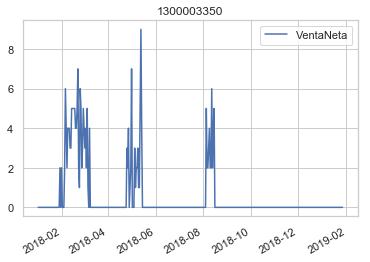

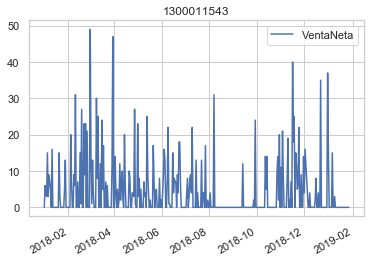

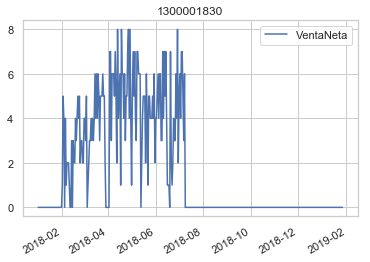

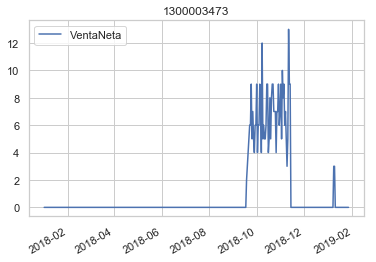

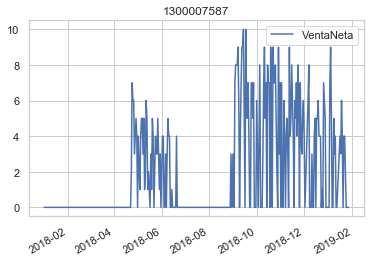

...

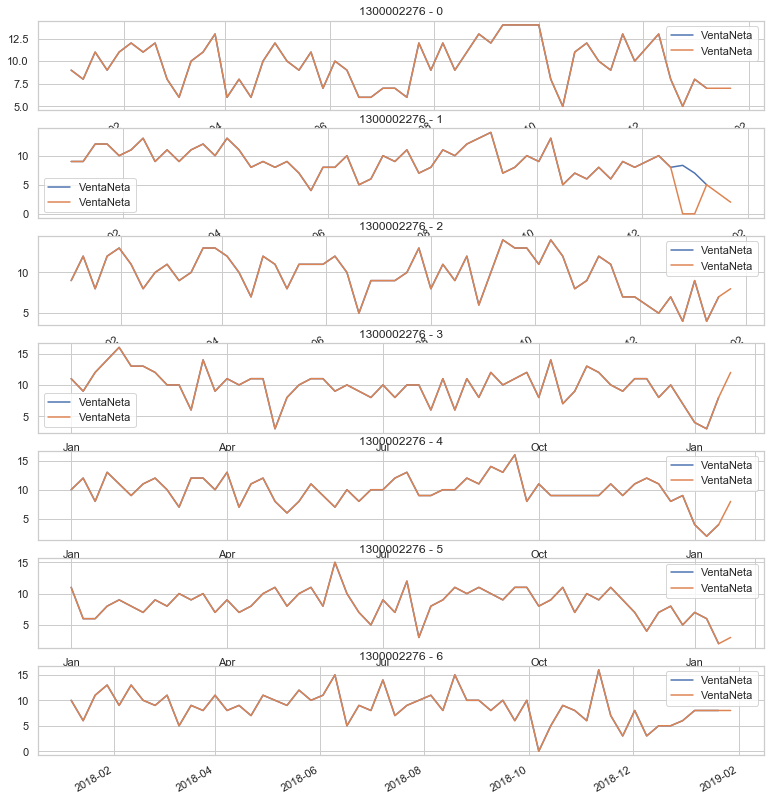

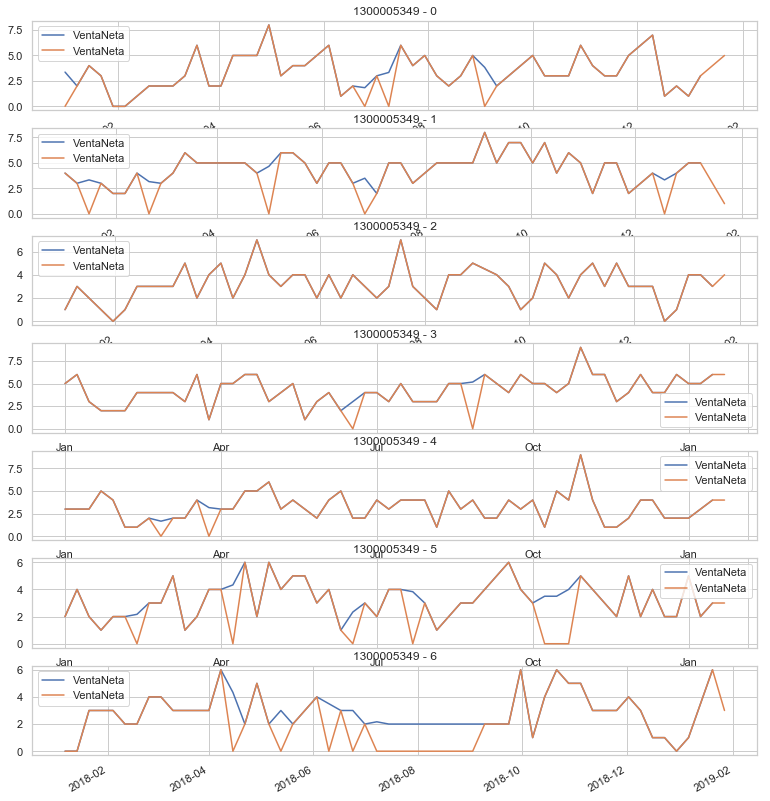

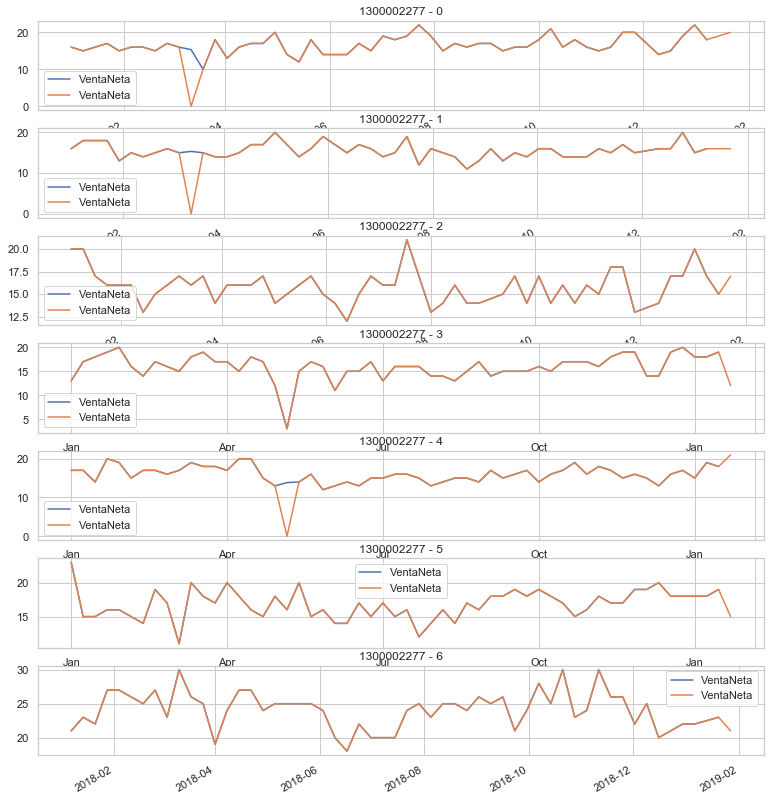

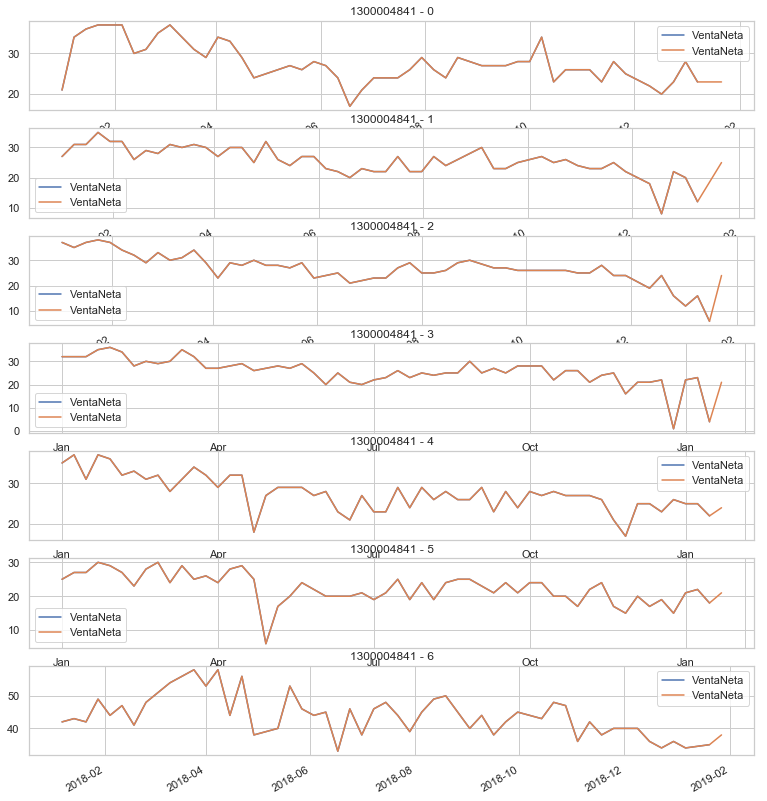

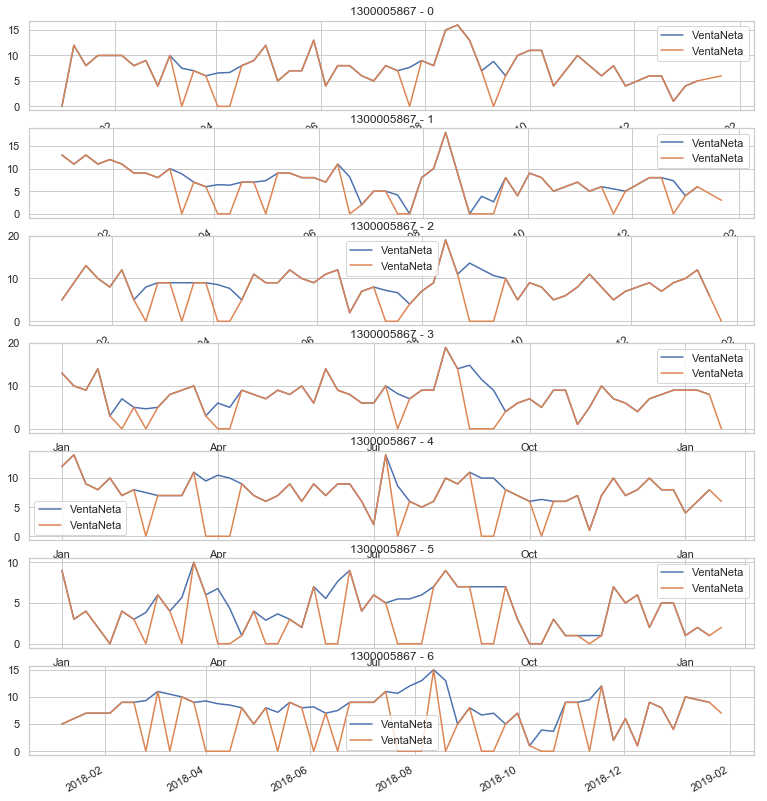

In [15]:
%%time
dicc_jesus_maria = extractor_21_27.populate_data(1200000047)

In [16]:
df[df['CodigoSapCanilla'] == 1300005890]['2019-01-10':'2019-01-20'][['VentaNeta', col_proy]]

,VentaNeta,Vta. Proy
2019-01-10,2,NaN
2019-01-11,2,NaN
2019-01-12,2,NaN
2019-01-16,1,NaN
2019-01-17,3,NaN
2019-01-18,2,NaN
2019-01-19,0,NaN
2019-01-20,0,NaN


In [17]:
%%time
# dicc_callao = extractor_21_27.populate_data(1200000065)

CPU times: user 6 µs, sys: 0 ns, total: 6 µs
Wall time: 11.2 µs


In [18]:
%%time
# dicc_canto_grande = extractor_21_27.populate_data(1200001015)

CPU times: user 15 µs, sys: 0 ns, total: 15 µs
Wall time: 26.9 µs


In [19]:
%%time
# dicc_lince = extractor_21_27.populate_data(1200000026)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs


In [20]:
%%time
# dicc_olivos = extractor_21_27.populate_data(1200000077)

CPU times: user 8 µs, sys: 0 ns, total: 8 µs
Wall time: 13.1 µs


In [21]:
%%time
# dicc_miraflores = extractor_21_27.populate_data(1200000044)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.44 µs


In [22]:
nulos = 0
for k, v in dicc_jesus_maria.items():
    for num_day, datus in v.items():
        nulos += datus.isnull().sum()
print(nulos)

0


In [23]:
"""
nulos = 0
for k, v in dicc_callao.items():
    for num_day, datus in v.items():
        nulos += datus.isnull().sum()
print(nulos)
"""

'\nnulos = 0\nfor k, v in dicc_callao.items():\n    for num_day, datus in v.items():\n        nulos += datus.isnull().sum()\nprint(nulos)\n'

In [24]:
"""
nulos = 0
for k, v in dicc_canto_grande.items():
    for num_day, datus in v.items():
        nulos += datus.isnull().sum()
print(nulos)
"""

'\nnulos = 0\nfor k, v in dicc_canto_grande.items():\n    for num_day, datus in v.items():\n        nulos += datus.isnull().sum()\nprint(nulos)\n'

In [25]:
"""
nulos = 0
for k, v in dicc_olivos.items():
    for num_day, datus in v.items():
        nulos += datus.isnull().sum()
print(nulos)
"""

'\nnulos = 0\nfor k, v in dicc_olivos.items():\n    for num_day, datus in v.items():\n        nulos += datus.isnull().sum()\nprint(nulos)\n'

In [26]:
"""
nulos = 0
for k, v in dicc_miraflores.items():
    for num_day, datus in v.items():
        nulos += datus.isnull().sum()
print(nulos)
"""

'\nnulos = 0\nfor k, v in dicc_miraflores.items():\n    for num_day, datus in v.items():\n        nulos += datus.isnull().sum()\nprint(nulos)\n'

In [27]:
def reemplace_percentile(val, val_smaller, val_bigger):     
    if val < val_smaller:
        return val_smaller
    elif val > val_bigger:
        return val_bigger
    return val

In [28]:
def noise_control(dicc_data, cut_down, cut_up):
    for k, v in dicc_data.items():
        for num_day, datus in v.items():
            #fig, axes = plt.subplots(nrows=1, ncols=1)
            #datus.plot(legend=True, ax=axes, title='{} - {}'.format(k, num_day))
            
            quantile_5 = int(datus.quantile(cut_down))
            quantile_95 = int(datus.quantile(cut_up))     
            
            if datus[-3:].mean() != datus[-1] and datus[-3:].mean() != datus[-2]:
                datus = datus.apply(lambda x: reemplace_percentile(x, quantile_5, quantile_95))
            else:
                print("Relacion Lineal : ", k, num_day, datus[-5:].values, datus[-1])
            #datus.plot(legend=True, ax=axes)
            
    return dicc_data

In [29]:
%%time
cut_up = 95/100
cut_down = 5/100

dicc_jesus_maria = noise_control(dicc_jesus_maria, cut_down, cut_up)

Relacion Lineal :  1300005890 4 [3 1 2 2 2] 2
Relacion Lineal :  1300005890 6 [0 0 0 0 0] 0
Relacion Lineal :  1300007428 0 [4 4 1 5 3] 3
Relacion Lineal :  1300007428 5 [1 1 1 1 1] 1
Relacion Lineal :  1300007428 6 [1 1 1 1 1] 1
Relacion Lineal :  1300005892 6 [0 0 0 0 0] 0
Relacion Lineal :  1300005897 1 [1 2 0 0 0] 0
Relacion Lineal :  1300005897 3 [2 2 2 2 2] 2
Relacion Lineal :  1300005897 6 [0 0 0 0 0] 0
Relacion Lineal :  1300004878 5 [5 2 2 3 4] 4
Relacion Lineal :  1300015120 5 [ 7  9 11 12 13] 13
Relacion Lineal :  1300003349 3 [7. 6. 9. 7. 5.] 5.0
Relacion Lineal :  1300000797 0 [13  0  0  0  0] 0
Relacion Lineal :  1300000797 1 [11  0  0  0  0] 0
Relacion Lineal :  1300000797 2 [0 0 0 0 0] 0
Relacion Lineal :  1300000797 3 [0 0 0 0 0] 0
Relacion Lineal :  1300000797 4 [0 0 0 0 0] 0
Relacion Lineal :  1300000797 5 [0 0 0 0 0] 0
Relacion Lineal :  1300000797 6 [0 0 0 0 0] 0
Relacion Lineal :  1300003871 0 [3 4 3 3 3] 3
Relacion Lineal :  1300003871 1 [3.  3.  2.  2.5 3. ] 3.0

In [30]:
%%time
# dicc_callao = noise_control(dicc_callao, cut_down, cut_up)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.25 µs


In [31]:
%%time
# dicc_canto_grande = noise_control(dicc_canto_grande, cut_down, cut_up)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 9.54 µs


In [32]:
%%time
# dicc_lince = noise_control(dicc_lince, cut_down, cut_up)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.44 µs


In [33]:
%%time
# dicc_olivos = noise_control(dicc_olivos, cut_down, cut_up)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 6.2 µs


In [34]:
%%time
# dicc_miraflores = noise_control(dicc_miraflores, cut_down, cut_up)

CPU times: user 6 µs, sys: 0 ns, total: 6 µs
Wall time: 11.9 µs


In [35]:
from statsmodels.tsa.arima_model import ARIMA
from itertools import product

ps = range(2, 5)
d=1 
qs = range(2, 5)
Ps = range(0, 2)
D=1 
Qs = range(0, 2)
s = 4 # Semanal

parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

36

In [36]:
import statsmodels.api as sm
import warnings
warnings.filterwarnings('ignore')

def optimizeSARIMA(data, parameters_list, d, D, s):
    try:
        results = []
        best_bic = 1000000
        best_model = None

        for param in parameters_list:

            try:
                model=sm.tsa.statespace.SARIMAX(
                    data, 
                    order=(param[0], d, param[1]),
                    seasonal_order=(param[2], D, param[3], s)
                ).fit(disp=-1)
            except:
                continue
            else:
                bic = model.bic
                if bic < best_bic:
                    best_model = model
                    best_bic = bic
                    best_param = param
        
        print("Mejores parametros : ", best_param)
        return best_model
    except Exception as e:
        print("ERROR:::::: ", str(e))
        return None

In [37]:
%%time

def modeling(dicc_data):
    dicc_result = {}
    for k, v in dicc_data.items():
        dicc_result[k] = {}
        for num_day, datus in v.items():

            if datus[-3:].mean() == datus[-1] and datus[-3:].mean() == datus[-2]:
                print("Prediccion lineal :", k, num_day, datus[-3:].values, datus[-1])
                dicc_result[k][num_day] = datus[-1]
            else:
                try:
                    print("--------> ", k, num_day)
                    model = optimizeSARIMA(datus, parameters_list, d, D, s)
                    if not model:
                        raise Exception('Modelo Nulo retornado')
                        
                    lendata = datus.shape[0]
                    forecast = model.predict(start=lendata, end=lendata + 1)
                    print('Prediccion sarimax ', k, num_day, datus[-3:].values,forecast.values[0])
                    dicc_result[k][num_day] = forecast.values[0]
                except Exception as e:
                    print("ERROR : ", str(e))
                    print("TOMARA EL PROMEDIO DE LOS 3 ULTIMOS VALORES", k, num_day, datus[-3:].values, datus[-3:].mean())
                    dicc_result[k][num_day] = datus[-3:].mean()
                
    return dicc_result

CPU times: user 0 ns, sys: 29 µs, total: 29 µs
Wall time: 34.1 µs


In [38]:
%%time
dicc_result_jesus_maria = modeling(dicc_jesus_maria)

-------->  1300005890 0
Mejores parametros :  (2, 2, 1, 1)
Prediccion sarimax  1300005890 0 [0.66666667 1.         1.        ] 0.7292136859097309
-------->  1300005890 1
Mejores parametros :  (2, 3, 0, 1)
Prediccion sarimax  1300005890 1 [1.25 1.5  2.  ] 1.187720266062784
-------->  1300005890 2
Mejores parametros :  (2, 3, 0, 1)
Prediccion sarimax  1300005890 2 [1.66666667 1.         1.        ] 2.057444036615129
-------->  1300005890 3
Mejores parametros :  (2, 2, 1, 1)
Prediccion sarimax  1300005890 3 [2.33333333 2.         3.        ] 2.204023971164134
Prediccion lineal : 1300005890 4 [2 2 2] 2
-------->  1300005890 5
Mejores parametros :  (2, 2, 0, 1)
Prediccion sarimax  1300005890 5 [1.66666667 2.         1.94444444] 1.7415082517246447
Prediccion lineal : 1300005890 6 [0 0 0] 0
-------->  1300007428 0
Mejores parametros :  (2, 2, 0, 1)
Prediccion sarimax  1300007428 0 [1 5 3] 4.27198642445715
-------->  1300007428 1
Mejores parametros :  (2, 2, 0, 1)
Prediccion sarimax  130000742

In [39]:
df[df['CodigoSapCanilla'] == 1300005890].tail(14)

,Producto,Fecha,CodigoSapAgencia,NombreAgencia,CodigoSapCanilla,NombreCanilla,Pauta,Devolucion,VentaNeta,Lim. Inf Vta. Proy,Vta. Proy,Lim. Sup Vta. Proy,weekday
2019-01-21,Peru 21,2019-01-21,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,2,1,1,0.429457,0.854109,1.278761,0
2019-01-22,Peru 21,2019-01-22,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,2,1,1,0.517775,0.943885,1.369995,1
2019-01-23,Peru 21,2019-01-23,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,4,2,2,0.828306,1.205516,1.582725,2
2019-01-24,Peru 21,2019-01-24,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,3,0,3,1.432158,1.790901,2.149644,3
2019-01-25,Peru 21,2019-01-25,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,3,2,1,1.303033,1.717946,2.132859,4
2019-01-26,Peru 21,2019-01-26,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,0,0,0,0.000000,0.000000,0.000000,5
2019-01-27,Peru 21,2019-01-27,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,0,0,0,0.000000,0.000000,0.000000,6
2019-01-28,PERU 21,2019-01-28,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,3,1,2,0.491804,0.908282,1.324760,0
2019-01-29,PERU 21,2019-01-29,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,2,1,1,0.521269,0.939838,1.358406,1
2019-01-30,PERU 21,2019-01-30,1200000047,JESUS MARIA,1300005890,RAMON BARZOLA MANUEL,3,1,2,1.057559,1.427870,1.798181,2


In [40]:
%%time
# dicc_result_callao = modeling(dicc_callao)

CPU times: user 5 µs, sys: 0 ns, total: 5 µs
Wall time: 9.3 µs


In [41]:
%%time
# dicc_result_canto_grande = modeling(dicc_canto_grande)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 6.91 µs


In [42]:
%%time
# dicc_result_lince = modeling(dicc_lince)

CPU times: user 7 µs, sys: 0 ns, total: 7 µs
Wall time: 11.7 µs


In [43]:
%%time
# dicc_result_olivos = modeling(dicc_olivos)

CPU times: user 6 µs, sys: 0 ns, total: 6 µs
Wall time: 11.4 µs


In [44]:
%%time
# dicc_result_miraflores = modeling(dicc_miraflores)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 6.2 µs


In [52]:
def compare_result(data, codigo_canilla, dicc_predict, order, axes):
    result = sorted(dicc_predict.items(), key=lambda _: _[0])
    
    result = pd.DataFrame(
        data=[_[1].values[0] if isinstance(_[1], pd.Series) else _[1] for _ in result],
        index=[_[0] for _ in result] 
    )
    result.columns = ['Sarimax_bic']
    result['weekday'] = result.index
    
    old_result = pd.DataFrame(
        data[data['CodigoSapCanilla'] == codigo_canilla
            ][['VentaNeta', col_proy, 'weekday', 'Fecha']]['2019-01-21':'2019-01-27']
    )
    result = pd.merge(result, old_result, on='weekday', how='inner')
    del old_result
    
    result['diff_venta_holt'] = result['VentaNeta'] - result[col_proy]
    result['diff_venta_holtwinters'] = result['VentaNeta'] - result['Sarimax_bic']
    result.index = result.Fecha
    del result['Fecha']
    del result['weekday']
    del result.index.name
    
    result['round_ProyHolt'] = result[col_proy].apply(lambda _: round(_) if _ > 0 else 0)
    result['round_HoltWinters'] = result['Sarimax_bic'].apply(lambda _: round(_) if _ > 0 else 0)
    
    result['diff_int_ventaholt'] = result['VentaNeta'] - result['round_ProyHolt']
    result['diff_int_ventawinters'] = result['VentaNeta'] - result['round_HoltWinters']
    

    print('/'*10, "SUMA DE ERRORES", '/'*10, 
          data[data['CodigoSapCanilla'] == codigo_canilla]['NombreAgencia'].unique(),
          codigo_canilla)
    print("PROY HOLT___ decimal: {}  , entera: {}".format(
        sum(np.abs(result['diff_venta_holt'])), sum(np.abs(result['diff_int_ventaholt']))
    ))
    print("HOLT WINTERS___ decimal: {}  , entera: {}".format(
        sum(np.abs(result['diff_venta_holtwinters'])), sum(np.abs(result['diff_int_ventawinters']))
    ))

    result[col_proy].plot(legend=True, ax=axes[order], title=str(codigo_canilla))
    result['Sarimax_bic'].plot(legend=True, ax=axes[order])
    result['VentaNeta'].plot(legend=True, ax=axes[order])
    display(result)
    return result, sum(np.abs(result['diff_int_ventaholt'])), sum(np.abs(result['diff_int_ventawinters']))

////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005890
PROY HOLT___ decimal: 2.923535510094328  , entera: 3
HOLT WINTERS___ decimal: 4.053434897328692  , entera: 4


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.729214,1,0.854109,0.145891,0.270786,1,1,0,0
2019-01-22,1.187720,1,0.943885,0.056115,-0.187720,1,1,0,0
2019-01-23,2.057444,2,1.205516,0.794484,-0.057444,1,2,1,0
2019-01-24,2.204024,3,1.790901,1.209099,0.795976,2,2,1,1
2019-01-25,2.000000,1,1.717946,-0.717946,-1.000000,2,2,-1,-1
2019-01-26,1.741508,0,0.000000,0.000000,-1.741508,0,2,0,-2
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007428
PROY HOLT___ decimal: 2.555175905958988  , entera: 2
HOLT WINTERS___ decimal: 5.810405072218591  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.271986,3,3.786805,-0.786805,-1.271986,4,4,-1,-1
2019-01-22,3.775212,3,3.079727,-0.079727,-0.775212,3,4,0,-1
2019-01-23,4.780450,3,4.178184,-1.178184,-1.780450,4,5,-1,-2
2019-01-24,3.716426,3,3.177796,-0.177796,-0.716426,3,4,0,-1
2019-01-25,4.266331,3,3.257250,-0.257250,-1.266331,3,4,0,-1
2019-01-26,1.000000,1,1.030639,-0.030639,0.000000,1,1,0,0
2019-01-27,1.000000,1,1.044776,-0.044776,0.000000,1,1,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005892
PROY HOLT___ decimal: 4.178007063925899  , entera: 4
HOLT WINTERS___ decimal: 6.347712790525351  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.256621,2,1.806134,0.193866,0.743379,2,1,0,1
2019-01-22,2.508593,2,2.145064,-0.145064,-0.508593,2,3,0,-1
2019-01-23,1.411868,0,1.562699,-1.562699,-1.411868,2,1,-2,-1
2019-01-24,2.034708,3,1.543930,1.456070,0.965292,2,2,1,1
2019-01-25,1.761230,1,1.820308,-0.820308,-0.761230,2,2,-1,-1
2019-01-26,1.957350,0,0.000000,0.000000,-1.957350,0,2,0,-2
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005897
PROY HOLT___ decimal: 3.245155615190672  , entera: 3
HOLT WINTERS___ decimal: 6.3115020965503925  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.462872,1,1.281001,-0.281001,0.537128,1,0,0,1
2019-01-22,0.000000,1,1.209369,-0.209369,1.000000,1,0,0,1
2019-01-23,2.471089,0,1.134688,-1.134688,-2.471089,1,2,-1,-2
2019-01-24,2.000000,1,1.729643,-0.729643,-1.000000,2,2,-1,-1
2019-01-25,0.491175,1,1.733090,-0.733090,0.508825,2,0,-1,1
2019-01-26,2.794460,2,2.157365,-0.157365,-0.794460,2,3,0,-1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004878
PROY HOLT___ decimal: 9.307793829757719  , entera: 10
HOLT WINTERS___ decimal: 12.385393674214903  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.485413,1,3.158462,-2.158462,-3.485413,3,4,-2,-3
2019-01-22,1.731409,4,0.300386,3.699614,2.268591,0,2,4,2
2019-01-23,2.211692,4,3.137917,0.862083,1.788308,3,2,1,2
2019-01-24,1.589019,2,2.011276,-0.011276,0.410981,2,2,0,0
2019-01-25,3.923208,5,3.487088,1.512912,1.076792,3,4,2,1
2019-01-26,4.583585,3,2.694407,0.305593,-1.583585,3,5,0,-2
2019-01-27,4.228276,6,5.242147,0.757853,1.771724,5,4,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300015120
PROY HOLT___ decimal: 14.833944434971277  , entera: 13
HOLT WINTERS___ decimal: 13.000000000000002  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,14.333333,14,13.578258,0.421742,-0.333333,14,14,0,0
2019-01-22,14.333333,13,13.379457,-0.379457,-1.333333,13,14,0,-1
2019-01-23,11.333333,16,12.609164,3.390836,4.666667,13,11,3,5
2019-01-24,12.000000,13,13.702915,-0.702915,1.000000,14,12,-1,1
2019-01-25,10.666667,13,12.757368,0.242632,2.333333,13,11,0,2
2019-01-26,12.000000,11,14.324183,-3.324183,-1.000000,14,12,-3,-1
2019-01-27,13.333333,11,17.372179,-6.372179,-2.333333,17,13,-6,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003349
PROY HOLT___ decimal: 10.985094570754246  , entera: 11
HOLT WINTERS___ decimal: 13.221762629741031  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.180783,5,7.545310,-2.545310,-3.180783,8,8,-3,-3
2019-01-22,9.126156,4,8.109986,-4.109986,-5.126156,8,9,-4,-5
2019-01-23,7.484246,6,6.811099,-0.811099,-1.484246,7,7,-1,-1
2019-01-24,6.553438,7,5.796143,1.203857,0.446562,6,7,1,0
2019-01-25,8.284201,7,7.445681,-0.445681,-1.284201,7,8,0,-1
2019-01-26,8.829563,10,8.135465,1.864535,1.170437,8,9,2,1
2019-01-27,11.470621,12,11.995373,0.004627,0.529379,12,11,0,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000279
PROY HOLT___ decimal: 13.457701336047503  , entera: 14
HOLT WINTERS___ decimal: 16.60324672524694  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.711831,7,4.891675,2.108325,-0.711831,5,8,2,-1
2019-01-22,4.371503,3,4.447139,-1.447139,-1.371503,4,4,-1,-1
2019-01-23,4.336689,7,6.000424,0.999576,2.663311,6,4,1,3
2019-01-24,2.667312,8,4.418338,3.581662,5.332688,4,3,4,5
2019-01-25,4.910166,2,4.590172,-2.590172,-2.910166,5,5,-3,-3
2019-01-26,4.880805,6,3.811386,2.188614,1.119195,4,5,2,1
2019-01-27,5.494552,3,3.542214,-0.542214,-2.494552,4,5,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000797
PROY HOLT___ decimal: 82.5258782866526  , entera: 82
HOLT WINTERS___ decimal: 0  , entera: 0


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0,0,14.168514,-14.168514,0,14,0,-14,0
2019-01-22,0,0,11.951719,-11.951719,0,12,0,-12,0
2019-01-23,0,0,10.248827,-10.248827,0,10,0,-10,0
2019-01-24,0,0,10.343976,-10.343976,0,10,0,-10,0
2019-01-25,0,0,11.146027,-11.146027,0,11,0,-11,0
2019-01-26,0,0,9.942091,-9.942091,0,10,0,-10,0
2019-01-27,0,0,14.724725,-14.724725,0,15,0,-15,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003871
PROY HOLT___ decimal: 4.247516674159284  , entera: 4
HOLT WINTERS___ decimal: 5.20459882199731  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.000000,3,3.274014,-0.274014,0.000000,3,3,0,0
2019-01-22,2.495832,3,2.939653,0.060347,0.504168,3,2,0,1
2019-01-23,2.476657,3,2.966902,0.033098,0.523343,3,2,0,1
2019-01-24,3.000000,2,3.008989,-1.008989,-1.000000,3,3,-1,-1
2019-01-25,3.000000,2,3.015872,-1.015872,-1.000000,3,3,-1,-1
2019-01-26,2.569987,2,2.765463,-0.765463,-0.569987,3,3,-1,-1
2019-01-27,3.607100,2,3.089732,-1.089732,-1.607100,3,4,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005410
PROY HOLT___ decimal: 10.379166541053756  , entera: 10
HOLT WINTERS___ decimal: 13.98086958197246  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,15.304777,17,18.370521,-1.370521,1.695223,18,15,-1,2
2019-01-22,15.804438,14,16.300638,-2.300638,-1.804438,16,16,-2,-2
2019-01-23,18.282761,22,18.602171,3.397829,3.717239,19,18,3,4
2019-01-24,16.377001,15,14.316937,0.683063,-1.377001,14,16,1,-1
2019-01-25,17.441810,16,15.170913,0.829087,-1.441810,15,17,1,-1
2019-01-26,16.058307,16,15.382958,0.617042,-0.058307,15,16,1,0
2019-01-27,25.886853,22,23.180987,-1.180987,-3.886853,23,26,-1,-4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005411
PROY HOLT___ decimal: 6.657478450462467  , entera: 6
HOLT WINTERS___ decimal: 5.055508554053864  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.357087,13,11.979197,1.020803,0.642913,12,12,1,1
2019-01-22,10.616697,10,11.250461,-1.250461,-0.616697,11,11,-1,-1
2019-01-23,12.200208,12,11.854524,0.145476,-0.200208,12,12,0,0
2019-01-24,10.876501,11,10.169154,0.830846,0.123499,10,11,1,0
2019-01-25,11.986211,13,12.360393,0.639607,1.013789,12,12,1,1
2019-01-26,13.081975,15,12.605402,2.394598,1.918025,13,13,2,2
2019-01-27,16.540377,16,15.624314,0.375686,-0.540377,16,17,0,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005434
PROY HOLT___ decimal: 13.25264177775512  , entera: 14
HOLT WINTERS___ decimal: 15.818006332226947  , entera: 17


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,5.620146,2,4.709840,-2.709840,-3.620146,5,6,-3,-4
2019-01-22,3.493007,6,3.627158,2.372842,2.506993,4,3,2,3
2019-01-23,4.076205,5,4.781199,0.218801,0.923795,5,4,0,1
2019-01-24,2.998917,2,4.752207,-2.752207,-0.998917,5,3,-3,-1
2019-01-25,3.457996,5,3.285913,1.714087,1.542004,3,3,2,2
2019-01-26,5.044011,2,4.753892,-2.753892,-3.044011,5,5,-3,-3
2019-01-27,1.817859,5,4.269028,0.730972,3.182141,4,2,1,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005440
PROY HOLT___ decimal: 29.55365870268931  , entera: 31
HOLT WINTERS___ decimal: 35.549133829534114  , entera: 37


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.013724,15,11.223687,3.776313,3.986276,11,11,4,4
2019-01-22,8.395053,12,8.315260,3.684740,3.604947,8,8,4,4
2019-01-23,4.748930,17,10.474015,6.525985,12.251070,10,5,7,12
2019-01-24,7.166512,15,8.274490,6.725510,7.833488,8,7,7,8
2019-01-25,9.283938,12,8.802203,3.197797,2.716062,9,9,3,3
2019-01-26,7.370506,10,7.353500,2.646500,2.629494,7,7,3,3
2019-01-27,9.472204,12,9.003186,2.996814,2.527796,9,9,3,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001345
PROY HOLT___ decimal: 20.051619743296634  , entera: 21
HOLT WINTERS___ decimal: 12.832123935093465  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.281506,4,7.732035,-3.732035,0.718494,8,3,-4,1
2019-01-22,2.793921,3,8.015580,-5.015580,0.206079,8,3,-5,0
2019-01-23,4.313975,7,5.236243,1.763757,2.686025,5,4,2,3
2019-01-24,4.246709,7,4.055111,2.944889,2.753291,4,4,3,3
2019-01-25,3.527895,1,2.604321,-1.604321,-2.527895,3,4,-2,-3
2019-01-26,3.940339,0,4.991038,-4.991038,-3.940339,5,4,-5,-4
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001347
PROY HOLT___ decimal: 5.8228795784547565  , entera: 6
HOLT WINTERS___ decimal: 5.7933148963223156  , entera: 5


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.568793,3,2.106923,0.893077,1.431207,2,2,1,1
2019-01-22,1.507325,3,1.338180,1.661820,1.492675,1,2,2,1
2019-01-23,1.357534,2,1.672662,0.327338,0.642466,2,1,0,1
2019-01-24,1.638436,2,1.386792,0.613208,0.361564,1,2,1,0
2019-01-25,0.904457,0,2.106454,-2.106454,-0.904457,2,1,-2,-1
2019-01-26,5.039053,6,5.779016,0.220984,0.960947,6,5,0,1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004426
PROY HOLT___ decimal: 8.088687629369225  , entera: 8
HOLT WINTERS___ decimal: 12.276666127563331  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.924572,4,5.240175,-1.240175,-0.924572,5,5,-1,-1
2019-01-22,2.371846,4,2.874890,1.125110,1.628154,3,2,1,2
2019-01-23,5.858102,2,4.374221,-2.374221,-3.858102,4,6,-2,-4
2019-01-24,3.103024,5,3.871917,1.128083,1.896976,4,3,1,2
2019-01-25,4.356785,3,3.932675,-0.932675,-1.356785,4,4,-1,-1
2019-01-26,4.591702,3,3.535345,-0.535345,-1.591702,4,5,-1,-2
2019-01-27,6.979625,8,7.246920,0.753080,1.020375,7,7,1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013643
PROY HOLT___ decimal: 7.763449059292317  , entera: 8
HOLT WINTERS___ decimal: 8.818955914881986  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.987771,11,9.044798,1.955202,3.012229,9,8,2,3
2019-01-22,6.823962,9,9.560210,-0.560210,2.176038,10,7,-1,2
2019-01-23,7.251297,7,8.019864,-1.019864,-0.251297,8,7,-1,0
2019-01-24,7.781366,8,6.756794,1.243206,0.218634,7,8,1,0
2019-01-25,9.159405,7,9.692383,-2.692383,-2.159405,10,9,-3,-2
2019-01-26,3.998648,5,4.707416,0.292584,1.001352,5,4,0,1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013644
PROY HOLT___ decimal: 17.090966211158246  , entera: 17
HOLT WINTERS___ decimal: 14.90863488257893  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.442162,10,7.919014,2.080986,3.557838,8,6,2,4
2019-01-22,6.626209,9,8.142400,0.857600,2.373791,8,7,1,2
2019-01-23,8.482558,11,9.202525,1.797475,2.517442,9,8,2,3
2019-01-24,7.453827,9,8.369200,0.630800,1.546173,8,7,1,2
2019-01-25,8.188789,9,8.503668,0.496332,0.811211,9,8,0,1
2019-01-26,6.651886,10,8.772226,1.227774,3.348114,9,7,1,3
2019-01-27,9.245935,10,0.000000,10.000000,0.754065,0,9,10,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004427
PROY HOLT___ decimal: 7.759760480800791  , entera: 7
HOLT WINTERS___ decimal: 9.403471173932505  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.125840,7,6.104445,0.895555,-2.125840,6,9,1,-2
2019-01-22,7.308873,5,6.802207,-1.802207,-2.308873,7,7,-2,-2
2019-01-23,6.801583,6,7.370397,-1.370397,-0.801583,7,7,-1,-1
2019-01-24,7.263333,8,8.473977,-0.473977,0.736667,8,7,0,1
2019-01-25,7.380818,9,8.122798,0.877202,1.619182,8,7,1,2
2019-01-26,4.188674,6,4.132788,1.867212,1.811326,4,4,2,2
2019-01-27,7.000000,7,6.526790,0.473210,0.000000,7,7,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000845
PROY HOLT___ decimal: 26.653280071684545  , entera: 27
HOLT WINTERS___ decimal: 30.605778611022995  , entera: 30


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,23.539080,7,23.876291,-16.876291,-16.539080,24,24,-17,-17
2019-01-22,22.671866,19,20.833799,-1.833799,-3.671866,21,23,-2,-4
2019-01-23,20.672524,22,20.215593,1.784407,1.327476,20,21,2,1
2019-01-24,22.957921,23,23.471125,-0.471125,0.042079,23,23,0,0
2019-01-25,19.580462,25,20.019234,4.980766,5.419538,20,20,5,5
2019-01-26,16.536056,17,17.636783,-0.636783,0.463944,18,17,-1,0
2019-01-27,26.858205,30,29.929891,0.070109,3.141795,30,27,0,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000846
PROY HOLT___ decimal: 11.145046480118769  , entera: 11
HOLT WINTERS___ decimal: 13.520387027909877  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,21.435096,24,22.633578,1.366422,2.564904,23,21,1,3
2019-01-22,20.714778,22,21.876503,0.123497,1.285222,22,21,0,1
2019-01-23,22.116066,22,20.566476,1.433524,-0.116066,21,22,1,0
2019-01-24,21.551702,22,22.547693,-0.547693,0.448298,23,22,-1,0
2019-01-25,19.011636,23,19.967964,3.032036,3.988364,20,19,3,4
2019-01-26,18.459480,20,23.511028,-3.511028,1.540520,24,18,-4,2
2019-01-27,22.422986,26,27.130847,-1.130847,3.577014,27,22,-1,4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003922
PROY HOLT___ decimal: 4.627195153757796  , entera: 4
HOLT WINTERS___ decimal: 7.557075459368302  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.185241,3,3.308435,-0.308435,0.814759,3,2,0,1
2019-01-22,4.485936,6,4.592313,1.407687,1.514064,5,4,1,2
2019-01-23,5.748321,7,5.230242,1.769758,1.251679,5,6,2,1
2019-01-24,5.394496,7,6.106348,0.893652,1.605504,6,5,1,2
2019-01-25,4.178726,5,4.905285,0.094715,0.821274,5,4,0,1
2019-01-26,6.549795,5,4.978662,0.021338,-1.549795,5,7,0,-2
2019-01-27,3.000000,3,3.131611,-0.131611,0.000000,3,3,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004434
PROY HOLT___ decimal: 9.749578260596707  , entera: 10
HOLT WINTERS___ decimal: 10.826080723910598  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.731497,2,4.060778,-2.060778,-0.731497,4,3,-2,-1
2019-01-22,5.242843,3,3.728391,-0.728391,-2.242843,4,5,-1,-2
2019-01-23,1.806523,2,1.113100,0.886900,0.193477,1,2,1,0
2019-01-24,2.188717,4,1.801499,2.198501,1.811283,2,2,2,2
2019-01-25,1.151106,1,1.096086,-0.096086,-0.151106,1,1,0,0
2019-01-26,2.692693,0,3.778922,-3.778922,-2.692693,4,3,-4,-3
2019-01-27,3.003181,0,0.000000,0.000000,-3.003181,0,3,0,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300011094
PROY HOLT___ decimal: 10.26754976478674  , entera: 10
HOLT WINTERS___ decimal: 10.50126115326421  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.000000,3,1.940229,1.059771,1.000000,2,2,1,1
2019-01-22,2.663898,2,3.732288,-1.732288,-0.663898,4,3,-2,-1
2019-01-23,4.694496,2,4.172229,-2.172229,-2.694496,4,5,-2,-3
2019-01-24,1.000000,2,0.843260,1.156740,1.000000,1,1,1,1
2019-01-25,3.000000,4,1.940865,2.059135,1.000000,2,3,2,1
2019-01-26,2.750246,1,1.476757,-0.476757,-1.750246,1,3,0,-2
2019-01-27,2.607379,5,3.389370,1.610630,2.392621,3,3,2,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005468
PROY HOLT___ decimal: 5.009887600923543  , entera: 5
HOLT WINTERS___ decimal: 13.300680125590459  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.392379,6,5.186435,0.813565,4.607621,5,1,1,5
2019-01-22,4.856568,4,3.969374,0.030626,-0.856568,4,5,0,-1
2019-01-23,6.319390,4,4.123549,-0.123549,-2.319390,4,6,0,-2
2019-01-24,5.954829,6,3.822041,2.177959,0.045171,4,6,2,0
2019-01-25,4.911867,6,5.013521,0.986479,1.088133,5,5,1,1
2019-01-26,3.749879,3,3.515329,-0.515329,-0.749879,4,4,-1,-1
2019-01-27,0.366082,4,4.362381,-0.362381,3.633918,4,0,0,4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013666
PROY HOLT___ decimal: 17.576695970608963  , entera: 18
HOLT WINTERS___ decimal: 16.37285595284675  , entera: 18


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,15.562491,12,9.965365,2.034635,-3.562491,10,16,2,-4
2019-01-22,10.792321,10,8.580446,1.419554,-0.792321,9,11,1,-1
2019-01-23,9.531098,7,7.222036,-0.222036,-2.531098,7,10,0,-3
2019-01-24,11.626649,9,13.131403,-4.131403,-2.626649,13,12,-4,-3
2019-01-25,11.738373,9,11.705242,-2.705242,-2.738373,12,12,-3,-3
2019-01-26,9.365345,8,10.529132,-2.529132,-1.365345,11,9,-3,-1
2019-01-27,11.756580,9,13.534695,-4.534695,-2.756580,14,12,-5,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007525
PROY HOLT___ decimal: 12.095653231570505  , entera: 12
HOLT WINTERS___ decimal: 10.171311419508195  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.999240,10,13.369666,-3.369666,-2.999240,13,13,-3,-3
2019-01-22,10.779655,12,10.935729,1.064271,1.220345,11,11,1,1
2019-01-23,11.270978,11,12.329299,-1.329299,-0.270978,12,11,-1,0
2019-01-24,13.440259,15,13.380369,1.619631,1.559741,13,13,2,2
2019-01-25,13.021612,12,12.053795,-0.053795,-1.021612,12,13,0,-1
2019-01-26,12.570817,15,12.471992,2.528008,2.429183,12,13,3,2
2019-01-27,14.329787,15,12.869017,2.130983,0.670213,13,14,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003441
PROY HOLT___ decimal: 36.87429287092522  , entera: 37
HOLT WINTERS___ decimal: 17.668717473876427  , entera: 18


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.668717,0,6.820110,-6.820110,-9.668717,7,10,-7,-10
2019-01-22,0.000000,0,6.496199,-6.496199,0.000000,6,0,-6,0
2019-01-23,0.000000,0,3.429211,-3.429211,0.000000,3,0,-3,0
2019-01-24,0.000000,0,4.604439,-4.604439,0.000000,5,0,-5,0
2019-01-25,0.000000,0,4.593381,-4.593381,0.000000,5,0,-5,0
2019-01-26,0.000000,0,3.414447,-3.414447,0.000000,3,0,-3,0
2019-01-27,8.000000,0,7.516505,-7.516505,-8.000000,8,8,-8,-8


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000882
PROY HOLT___ decimal: 7.0023380839962535  , entera: 6
HOLT WINTERS___ decimal: 12.358524393164616  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.864270,15,14.513661,0.486339,2.135730,15,13,0,2
2019-01-22,5.837787,10,10.868773,-0.868773,4.162213,11,6,-1,4
2019-01-23,8.506410,10,9.910672,0.089328,1.493590,10,9,0,1
2019-01-24,9.135656,10,9.896464,0.103536,0.864344,10,9,0,1
2019-01-25,10.367996,9,9.917161,-0.917161,-1.367996,10,10,-1,-1
2019-01-26,7.903998,10,9.875876,0.124124,2.096002,10,8,0,2
2019-01-27,13.761350,14,9.586923,4.413077,0.238650,10,14,4,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003443
PROY HOLT___ decimal: 5.546340579235812  , entera: 6
HOLT WINTERS___ decimal: 9.023461481907677  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.147798,2,1.861633,0.138367,-0.147798,2,2,0,0
2019-01-22,3.385766,6,5.953087,0.046913,2.614234,6,3,0,3
2019-01-23,2.766381,2,3.229012,-1.229012,-0.766381,3,3,-1,-1
2019-01-24,3.740575,5,4.497565,0.502435,1.259425,4,4,1,1
2019-01-25,2.948082,5,3.370387,1.629613,2.051918,3,3,2,2
2019-01-26,4.183705,2,0.000000,2.000000,-2.183705,0,4,2,-2
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007035
PROY HOLT___ decimal: 9.341631117056453  , entera: 9
HOLT WINTERS___ decimal: 8.350440770888277  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,17.262059,16,18.016975,-2.016975,-1.262059,18,17,-2,-1
2019-01-22,16.608476,17,16.853478,0.146522,0.391524,17,17,0,0
2019-01-23,15.983439,18,16.230378,1.769622,2.016561,16,16,2,2
2019-01-24,17.050603,16,17.185299,-1.185299,-1.050603,17,17,-1,-1
2019-01-25,15.395642,17,14.641870,2.358130,1.604358,15,15,2,2
2019-01-26,15.826794,14,15.357246,-1.357246,-1.826794,15,16,-1,-2
2019-01-27,15.198541,15,15.507837,-0.507837,-0.198541,16,15,-1,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012159
PROY HOLT___ decimal: 17.95221995909835  , entera: 18
HOLT WINTERS___ decimal: 10.588730958836198  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.363152,10,12.676961,-2.676961,-0.363152,13,10,-3,0
2019-01-22,13.000000,8,13.120421,-5.120421,-5.000000,13,13,-5,-5
2019-01-23,11.544892,8,11.932479,-3.932479,-3.544892,12,12,-4,-4
2019-01-24,8.433485,8,9.452824,-1.452824,-0.433485,9,8,-1,0
2019-01-25,12.430079,12,12.938215,-0.938215,-0.430079,13,12,-1,0
2019-01-26,9.087750,9,9.983195,-0.983195,-0.087750,10,9,-1,0
2019-01-27,11.729372,11,13.848125,-2.848125,-0.729372,14,12,-3,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012160
PROY HOLT___ decimal: 21.860450313356246  , entera: 21
HOLT WINTERS___ decimal: 28.557804962455798  , entera: 27


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.445823,8,12.383033,-4.383033,-3.445823,12,11,-4,-3
2019-01-22,11.162509,11,11.263541,-0.263541,-0.162509,11,11,0,0
2019-01-23,0.780365,9,8.976687,0.023313,8.219635,9,1,0,8
2019-01-24,8.105524,12,10.739768,1.260232,3.894476,11,8,1,4
2019-01-25,12.429507,3,12.784401,-9.784401,-9.429507,13,12,-10,-9
2019-01-26,10.618294,12,11.756229,0.243771,1.381706,12,11,0,1
2019-01-27,14.024148,12,17.902158,-5.902158,-2.024148,18,14,-6,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012161
PROY HOLT___ decimal: 5.2618678127382505  , entera: 4
HOLT WINTERS___ decimal: 6.8881319640693714  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.310661,11,11.171413,-0.171413,-1.310661,11,12,0,-1
2019-01-22,10.592423,10,9.809731,0.190269,-0.592423,10,11,0,-1
2019-01-23,11.024809,12,10.987044,1.012956,0.975191,11,11,1,1
2019-01-24,10.855591,11,10.587555,0.412445,0.144409,11,11,0,0
2019-01-25,11.503445,13,11.783640,1.216360,1.496555,12,12,1,1
2019-01-26,9.439667,8,9.329177,-1.329177,-1.439667,9,9,-1,-1
2019-01-27,14.070774,15,14.070753,0.929247,0.929226,14,14,1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003466
PROY HOLT___ decimal: 15.9155722480249  , entera: 16
HOLT WINTERS___ decimal: 17.70403494487041  , entera: 17


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.586400,10,4.574744,5.425256,5.413600,5,5,5,5
2019-01-22,5.837524,3,4.995352,-1.995352,-2.837524,5,6,-2,-3
2019-01-23,2.720851,6,3.546045,2.453955,3.279149,4,3,2,3
2019-01-24,3.086190,5,4.386194,0.613806,1.913810,4,3,1,2
2019-01-25,4.823739,4,4.969253,-0.969253,-0.823739,5,5,-1,-1
2019-01-26,3.828293,5,4.077421,0.922579,1.171707,4,4,1,1
2019-01-27,12.735493,15,11.464630,3.535370,2.264507,11,13,4,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006547
PROY HOLT___ decimal: 6.00127711223882  , entera: 6
HOLT WINTERS___ decimal: 8.6091548276611  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.065454,4,5.195785,-1.195785,0.934546,5,3,-1,1
2019-01-22,0.000000,3,5.670939,-2.670939,3.000000,6,0,-3,3
2019-01-23,5.408799,4,4.667245,-0.667245,-1.408799,5,5,-1,-1
2019-01-24,4.855408,6,5.623501,0.376499,1.144592,6,5,0,1
2019-01-25,5.908196,7,6.296503,0.703497,1.091804,6,6,1,1
2019-01-26,6.029414,5,5.387312,-0.387312,-1.029414,5,6,0,-1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007061
PROY HOLT___ decimal: 17.35309379207876  , entera: 17
HOLT WINTERS___ decimal: 19.53048486911564  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.341603,8,8.556771,-0.556771,-0.341603,9,8,-1,0
2019-01-22,9.222064,8,6.996390,1.003610,-1.222064,7,9,1,-1
2019-01-23,7.894224,12,8.835875,3.164125,4.105776,9,8,3,4
2019-01-24,8.000000,10,8.006693,1.993307,2.000000,8,8,2,2
2019-01-25,7.130358,8,7.876582,0.123418,0.869642,8,7,0,1
2019-01-26,7.525139,0,8.429583,-8.429583,-7.525139,8,8,-8,-8
2019-01-27,20.466260,17,19.082280,-2.082280,-3.466260,19,20,-2,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004510
PROY HOLT___ decimal: 10.079684040354056  , entera: 10
HOLT WINTERS___ decimal: 15.437885945040994  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.725487,5,4.082422,0.917578,1.274513,4,4,1,1
2019-01-22,10.312392,5,4.727980,0.272020,-5.312392,5,10,0,-5
2019-01-23,4.891883,9,4.009521,4.990479,4.108117,4,5,5,4
2019-01-24,3.748151,3,4.355454,-1.355454,-0.748151,4,4,-1,-1
2019-01-25,4.141282,5,3.838645,1.161355,0.858718,4,4,1,1
2019-01-26,4.477052,3,3.817446,-0.817446,-1.477052,4,4,-1,-1
2019-01-27,3.341058,5,4.434647,0.565353,1.658942,4,3,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003489
PROY HOLT___ decimal: 11.279428816023373  , entera: 12
HOLT WINTERS___ decimal: 10.60812288483948  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.063111,2,1.386237,0.613763,0.936889,1,1,1,1
2019-01-22,1.143585,0,1.660124,-1.660124,-1.143585,2,1,-2,-1
2019-01-23,2.323738,6,2.166565,3.833435,3.676262,2,2,4,4
2019-01-24,2.333333,0,2.799304,-2.799304,-2.333333,3,2,-3,-2
2019-01-25,1.440469,3,1.533201,1.466799,1.559531,2,1,1,2
2019-01-26,0.958523,0,0.906004,-0.906004,-0.958523,1,1,-1,-1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005539
PROY HOLT___ decimal: 20.523769614377436  , entera: 21
HOLT WINTERS___ decimal: 18.66232105770609  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.675194,7,7.186628,-0.186628,0.324806,7,7,0,0
2019-01-22,5.277969,2,4.769660,-2.769660,-3.277969,5,5,-3,-3
2019-01-23,10.022913,6,9.028992,-3.028992,-4.022913,9,10,-3,-4
2019-01-24,6.674062,5,9.295087,-4.295087,-1.674062,9,7,-4,-2
2019-01-25,5.956651,6,5.499107,0.500893,0.043349,5,6,1,0
2019-01-26,8.646054,6,7.843256,-1.843256,-2.646054,8,9,-2,-3
2019-01-27,11.673168,5,12.899253,-7.899253,-6.673168,13,12,-8,-7


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001969
PROY HOLT___ decimal: 59.83330803631921  , entera: 60
HOLT WINTERS___ decimal: 52.5208811533965  , entera: 52


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,28.319641,22,14.869490,7.130510,-6.319641,15,28,7,-6
2019-01-22,40.214983,19,12.071138,6.928862,-21.214983,12,40,7,-21
2019-01-23,24.794674,26,18.151402,7.848598,1.205326,18,25,8,1
2019-01-24,19.233001,23,12.830275,10.169725,3.766999,13,19,10,4
2019-01-25,18.838514,26,15.538458,10.461542,7.161486,16,19,10,7
2019-01-26,19.072782,21,11.339258,9.660742,1.927218,11,19,10,2
2019-01-27,36.925228,26,18.366672,7.633328,-10.925228,18,37,8,-11


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006583
PROY HOLT___ decimal: 5.358179309043578  , entera: 4
HOLT WINTERS___ decimal: 7.196523975894599  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.076578,2,1.862934,0.137066,-0.076578,2,2,0,0
2019-01-22,2.044274,1,1.451789,-0.451789,-1.044274,1,2,0,-1
2019-01-23,2.317241,1,2.034080,-1.034080,-1.317241,2,2,-1,-1
2019-01-24,2.566335,2,2.088671,-0.088671,-0.566335,2,3,0,-1
2019-01-25,2.039234,3,2.576597,0.423403,0.960766,3,2,0,1
2019-01-26,1.163129,1,1.082736,-0.082736,-0.163129,1,1,0,0
2019-01-27,1.931799,5,1.859565,3.140435,3.068201,2,2,3,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004027
PROY HOLT___ decimal: 18.18443086994443  , entera: 18
HOLT WINTERS___ decimal: 18.329838861992144  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,22.112561,19,23.022489,-4.022489,-3.112561,23,22,-4,-3
2019-01-22,20.891595,18,21.522083,-3.522083,-2.891595,22,21,-4,-3
2019-01-23,20.000000,19,20.072417,-1.072417,-1.000000,20,20,-1,-1
2019-01-24,16.492306,18,17.778845,0.221155,1.507694,18,16,0,2
2019-01-25,19.000000,15,18.975191,-3.975191,-4.000000,19,19,-4,-4
2019-01-26,21.756686,17,21.003085,-4.003085,-4.756686,21,22,-4,-5
2019-01-27,32.061302,31,32.368011,-1.368011,-1.061302,32,32,-1,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004029
PROY HOLT___ decimal: 9.272396741577822  , entera: 9
HOLT WINTERS___ decimal: 13.881327097224002  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,-2.135058,4,1.948322,2.051678,6.135058,2,0,2,4
2019-01-22,2.562280,2,2.822948,-0.822948,-0.562280,3,3,-1,-1
2019-01-23,1.324312,0,1.196552,-1.196552,-1.324312,1,1,-1,-1
2019-01-24,1.131460,2,1.655481,0.344519,0.868540,2,1,0,1
2019-01-25,2.877465,1,2.595308,-1.595308,-1.877465,3,3,-2,-2
2019-01-26,1.613379,4,2.050894,1.949106,2.386621,2,2,2,2
2019-01-27,1.727052,1,2.312287,-1.312287,-0.727052,2,2,-1,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001989
PROY HOLT___ decimal: 8.680844205880675  , entera: 8
HOLT WINTERS___ decimal: 14.837946847790402  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,27.197690,23,24.279527,-1.279527,-4.197690,24,27,-1,-4
2019-01-22,23.761422,24,23.755089,0.244911,0.238578,24,24,0,0
2019-01-23,24.875527,21,24.149945,-3.149945,-3.875527,24,25,-3,-4
2019-01-24,23.618755,22,24.095762,-2.095762,-1.618755,24,24,-2,-2
2019-01-25,25.139205,22,22.744841,-0.744841,-3.139205,23,25,-1,-3
2019-01-26,23.744504,23,23.982378,-0.982378,-0.744504,24,24,-1,-1
2019-01-27,32.976313,34,33.816520,0.183480,1.023687,34,33,0,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005073
PROY HOLT___ decimal: 11.63290628826055  , entera: 12
HOLT WINTERS___ decimal: 18.217265989776447  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,21.103184,25,21.435920,3.564080,3.896816,21,21,4,4
2019-01-22,25.094722,23,23.638034,-0.638034,-2.094722,24,25,-1,-2
2019-01-23,21.875341,25,22.927667,2.072333,3.124659,23,22,2,3
2019-01-24,22.375100,25,22.129802,2.870198,2.624900,22,22,3,3
2019-01-25,20.289343,24,22.866832,1.133168,3.710657,23,20,1,4
2019-01-26,23.512981,22,22.311386,-0.311386,-1.512981,22,24,0,-2
2019-01-27,27.747470,29,30.043707,-1.043707,1.252530,30,28,-1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007635
PROY HOLT___ decimal: 9.96393823194484  , entera: 11
HOLT WINTERS___ decimal: 14.319988063227576  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.616901,6,5.307597,0.692403,1.383099,5,5,1,1
2019-01-22,7.808397,5,4.787747,0.212253,-2.808397,5,8,0,-3
2019-01-23,4.157269,4,3.487615,0.512385,-0.157269,3,4,1,0
2019-01-24,4.878216,6,4.289631,1.710369,1.121784,4,5,2,1
2019-01-25,4.878200,3,4.007507,-1.007507,-1.878200,4,5,-1,-2
2019-01-26,2.217319,5,3.492281,1.507719,2.782681,3,2,2,3
2019-01-27,7.811442,12,7.678698,4.321302,4.188558,8,8,4,4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004583
PROY HOLT___ decimal: 11.858179288654853  , entera: 12
HOLT WINTERS___ decimal: 12.90340763568694  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.673580,3,3.645424,-0.645424,-1.673580,4,5,-1,-2
2019-01-22,6.473877,7,4.273533,2.726467,0.526123,4,6,3,1
2019-01-23,5.593824,8,5.659438,2.340562,2.406176,6,6,2,2
2019-01-24,2.913730,6,3.213306,2.786694,3.086270,3,3,3,3
2019-01-25,4.212256,6,4.658644,1.341356,1.787744,5,4,1,2
2019-01-26,2.600597,4,2.798323,1.201677,1.399403,3,3,1,1
2019-01-27,3.975888,6,5.184001,0.815999,2.024112,5,4,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006634
PROY HOLT___ decimal: 6.872214700436169  , entera: 7
HOLT WINTERS___ decimal: 13.393068640215  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.692080,7,6.751996,0.248004,2.307920,7,5,0,2
2019-01-22,11.466999,7,7.551786,-0.551786,-4.466999,8,11,-1,-4
2019-01-23,6.294436,7,6.531927,0.468073,0.705564,7,6,0,1
2019-01-24,6.344952,8,6.651564,1.348436,1.655048,7,6,1,2
2019-01-25,6.286157,7,6.143216,0.856784,0.713843,6,6,1,1
2019-01-26,4.543694,4,4.645265,-0.645265,-0.543694,5,5,-1,-1
2019-01-27,11.000000,8,10.753868,-2.753868,-3.000000,11,11,-3,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012778
PROY HOLT___ decimal: 10.97631207892857  , entera: 12
HOLT WINTERS___ decimal: 14.493630187463978  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.933749,14,10.564169,3.435831,4.066251,11,10,3,4
2019-01-22,11.332602,12,11.407521,0.592479,0.667398,11,11,1,1
2019-01-23,7.892292,11,10.062292,0.937708,3.107708,10,8,1,3
2019-01-24,9.138224,10,9.447429,0.552571,0.861776,9,9,1,1
2019-01-25,12.070019,13,11.887017,1.112983,0.929981,12,12,1,1
2019-01-26,11.860517,10,10.628510,-0.628510,-1.860517,11,12,-1,-2
2019-01-27,18.000000,15,18.716230,-3.716230,-3.000000,19,18,-4,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006636
PROY HOLT___ decimal: 6.7064783606655  , entera: 6
HOLT WINTERS___ decimal: 13.817084608448258  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,20.115638,23,21.555748,1.444252,2.884362,22,20,1,3
2019-01-22,25.219639,23,22.540488,0.459512,-2.219639,23,25,0,-2
2019-01-23,20.618386,23,22.885621,0.114379,2.381614,23,21,0,2
2019-01-24,22.406733,25,23.172764,1.827236,2.593267,23,22,2,3
2019-01-25,19.796415,23,20.913899,2.086101,3.203585,21,20,2,3
2019-01-26,24.121032,24,24.708323,-0.708323,-0.121032,25,24,-1,0
2019-01-27,31.586414,32,32.066678,-0.066678,0.413586,32,32,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006638
PROY HOLT___ decimal: 9.626540234452191  , entera: 10
HOLT WINTERS___ decimal: 12.009079605762803  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,18.000000,14,18.179835,-4.179835,-4.000000,18,18,-4,-4
2019-01-22,16.188853,15,15.955756,-0.955756,-1.188853,16,16,-1,-1
2019-01-23,15.742124,15,15.956304,-0.956304,-0.742124,16,16,-1,-1
2019-01-24,14.281173,15,13.247109,1.752891,0.718827,13,14,2,1
2019-01-25,11.289187,14,13.714831,0.285169,2.710813,14,11,0,3
2019-01-26,13.130357,15,14.201203,0.798797,1.869643,14,13,1,2
2019-01-27,20.221180,21,20.302211,0.697789,0.778820,20,20,1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012779
PROY HOLT___ decimal: 4.262146330126367  , entera: 4
HOLT WINTERS___ decimal: 5.953325163392188  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.000000,2,1.203545,0.796455,2.000000,1,0,1,2
2019-01-22,1.883454,1,1.895850,-0.895850,-0.883454,2,2,-1,-1
2019-01-23,2.517046,1,2.413147,-1.413147,-1.517046,2,3,-1,-2
2019-01-24,2.229291,1,2.035845,-1.035845,-1.229291,2,2,-1,-1
2019-01-25,2.323534,2,2.120850,-0.120850,-0.323534,2,2,0,0
2019-01-26,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012780
PROY HOLT___ decimal: 10.784660911531823  , entera: 11
HOLT WINTERS___ decimal: 25.390386051259675  , entera: 26


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,14.014900,0,1.335445,-1.335445,-14.014900,1,14,-1,-14
2019-01-22,5.148731,10,7.708715,2.291285,4.851269,8,5,2,5
2019-01-23,10.290085,12,8.789105,3.210895,1.709915,9,10,3,2
2019-01-24,10.321982,12,10.437169,1.562831,1.678018,10,10,2,2
2019-01-25,12.072554,11,10.361484,0.638516,-1.072554,10,12,1,-1
2019-01-26,12.096706,12,10.468149,1.531851,-0.096706,10,12,2,0
2019-01-27,26.032976,28,27.786162,0.213838,1.967024,28,26,0,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012781
PROY HOLT___ decimal: 0.0  , entera: 0
HOLT WINTERS___ decimal: 0  , entera: 0


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0,0,0.0,0.0,0,0,0,0,0
2019-01-22,0,0,0.0,0.0,0,0,0,0,0
2019-01-23,0,0,0.0,0.0,0,0,0,0,0
2019-01-24,0,0,0.0,0.0,0,0,0,0,0
2019-01-25,0,0,0.0,0.0,0,0,0,0,0
2019-01-26,0,0,0.0,0.0,0,0,0,0,0
2019-01-27,0,0,0.0,0.0,0,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012269
PROY HOLT___ decimal: 22.818115019321176  , entera: 22
HOLT WINTERS___ decimal: 25.705166062746592  , entera: 25


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.085539,1,2.106666,-1.106666,-0.085539,2,1,-1,0
2019-01-22,2.165290,1,0.947906,0.052094,-1.165290,1,2,0,-1
2019-01-23,1.971164,1,1.355443,-0.355443,-0.971164,1,2,0,-1
2019-01-24,1.876682,0,2.086000,-2.086000,-1.876682,2,2,-2,-2
2019-01-25,1.474437,0,1.815906,-1.815906,-1.474437,2,1,-2,-1
2019-01-26,0.773623,2,0.860028,1.139972,1.226377,1,1,1,1
2019-01-27,18.905676,0,16.262035,-16.262035,-18.905676,16,19,-16,-19


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012782
PROY HOLT___ decimal: 4.36289795758977  , entera: 5
HOLT WINTERS___ decimal: 5.550561866214427  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,5.459674,6,5.886179,0.113821,0.540326,6,5,0,1
2019-01-22,3.930254,5,3.448736,1.551264,1.069746,3,4,2,1
2019-01-23,4.363693,5,4.827418,0.172582,0.636307,5,4,0,1
2019-01-24,4.229609,5,4.234326,0.765674,0.770391,4,4,1,1
2019-01-25,4.080593,5,4.229900,0.770100,0.919407,4,4,1,1
2019-01-26,5.452956,6,5.868369,0.131631,0.547044,6,5,0,1
2019-01-27,7.067341,6,6.857827,-0.857827,-1.067341,7,7,-1,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012783
PROY HOLT___ decimal: 9.103101296368877  , entera: 9
HOLT WINTERS___ decimal: 12.705893546930884  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.000000,4,7.130100,-3.130100,-3.000000,7,7,-3,-3
2019-01-22,6.713530,4,5.739699,-1.739699,-2.713530,6,7,-2,-3
2019-01-23,4.763922,4,3.894257,0.105743,-0.763922,4,5,0,-1
2019-01-24,5.186694,6,5.784655,0.215345,0.813306,6,5,0,1
2019-01-25,7.012408,5,7.302452,-2.302452,-2.012408,7,7,-2,-2
2019-01-26,0.788721,2,2.096003,-0.096003,1.211279,2,1,0,1
2019-01-27,9.191449,7,8.513759,-1.513759,-2.191449,9,9,-2,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012785
PROY HOLT___ decimal: 9.885280268409637  , entera: 9
HOLT WINTERS___ decimal: 8.975398090758137  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.975398,0,1.441613,-1.441613,-1.975398,1,2,-1,-2
2019-01-22,0.000000,0,4.073571,-4.073571,0.000000,4,0,-4,0
2019-01-23,0.000000,1,2.787797,-1.787797,1.000000,3,0,-2,1
2019-01-24,0.000000,3,1.665795,1.334205,3.000000,2,0,1,3
2019-01-25,0.000000,3,2.809985,0.190015,3.000000,3,0,0,3
2019-01-26,0.000000,0,1.058079,-1.058079,0.000000,1,0,-1,0
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013815
PROY HOLT___ decimal: 7.590696591567516  , entera: 7
HOLT WINTERS___ decimal: 7.010214008824388  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.000000,1,1.723115,-0.723115,1.000000,2,0,-1,1
2019-01-22,0.000000,0,1.955130,-1.955130,0.000000,2,0,-2,0
2019-01-23,1.054397,0,1.755615,-1.755615,-1.054397,2,1,-2,-1
2019-01-24,0.295589,0,1.377752,-1.377752,-0.295589,1,0,-1,0
2019-01-25,3.774747,0,1.066962,-1.066962,-3.774747,1,4,-1,-4
2019-01-26,1.489499,1,1.234798,-0.234798,-0.489499,1,1,0,0
2019-01-27,2.604017,3,2.522674,0.477326,0.395983,3,3,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013816
PROY HOLT___ decimal: 5.236376282987598  , entera: 5
HOLT WINTERS___ decimal: 10.784291695860755  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,14.848650,13,12.798928,0.201072,-1.848650,13,15,0,-2
2019-01-22,10.108548,9,9.309710,-0.309710,-1.108548,9,10,0,-1
2019-01-23,12.734478,14,12.183291,1.816709,1.265522,12,13,2,1
2019-01-24,6.164196,10,8.410056,1.589944,3.835804,8,6,2,4
2019-01-25,13.338064,13,13.112338,-0.112338,-0.338064,13,13,0,0
2019-01-26,9.755957,9,8.991444,0.008556,-0.755957,9,10,0,-1
2019-01-27,20.631747,19,20.198047,-1.198047,-1.631747,20,21,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007673
PROY HOLT___ decimal: 5.395976433934741  , entera: 6
HOLT WINTERS___ decimal: 7.7052253530274655  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.000000,9,7.901093,1.098907,1.000000,8,8,1,1
2019-01-22,8.701806,8,8.765961,-0.765961,-0.701806,9,9,-1,-1
2019-01-23,7.951985,9,8.474938,0.525062,1.048015,8,8,1,1
2019-01-24,9.104850,10,10.067343,-0.067343,0.895150,10,9,0,1
2019-01-25,7.933042,9,8.155386,0.844614,1.066958,8,8,1,1
2019-01-26,8.034535,7,8.260424,-1.260424,-1.034535,8,8,-1,-1
2019-01-27,8.041239,10,9.166336,0.833664,1.958761,9,8,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013811
PROY HOLT___ decimal: 10.834094091129053  , entera: 10
HOLT WINTERS___ decimal: 6.403219171527731  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.373071,6,5.661682,0.338318,-2.373071,6,8,0,-2
2019-01-22,4.393878,4,5.092984,-1.092984,-0.393878,5,4,-1,0
2019-01-23,5.546078,5,6.608307,-1.608307,-0.546078,7,6,-2,-1
2019-01-24,6.695697,6,5.864643,0.135357,-0.695697,6,7,0,-1
2019-01-25,4.934050,5,3.768424,1.231576,0.065950,4,5,1,0
2019-01-26,2.475793,2,5.086559,-3.086559,-0.475793,5,2,-3,0
2019-01-27,8.147248,10,6.659007,3.340993,1.852752,7,8,3,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013812
PROY HOLT___ decimal: 0.0  , entera: 0
HOLT WINTERS___ decimal: 0  , entera: 0


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0,0,0.0,0.0,0,0,0,0,0
2019-01-22,0,0,0.0,0.0,0,0,0,0,0
2019-01-23,0,0,0.0,0.0,0,0,0,0,0
2019-01-24,0,0,0.0,0.0,0,0,0,0,0
2019-01-25,0,0,0.0,0.0,0,0,0,0,0
2019-01-26,0,0,0.0,0.0,0,0,0,0,0
2019-01-27,0,0,0.0,0.0,0,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013813
PROY HOLT___ decimal: 9.687581387384819  , entera: 8
HOLT WINTERS___ decimal: 8.79148598136266  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.578153,4,5.424811,-1.424811,-0.578153,5,5,-1,-1
2019-01-22,5.253748,2,6.020204,-4.020204,-3.253748,6,5,-4,-3
2019-01-23,5.539467,3,2.733939,0.266061,-2.539467,3,6,0,-3
2019-01-24,0.744776,2,0.619576,1.380424,1.255224,1,1,1,1
2019-01-25,4.765240,5,2.895000,2.105000,0.234760,3,5,2,0
2019-01-26,3.069866,4,3.508918,0.491082,0.930134,4,3,0,1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006653
PROY HOLT___ decimal: 8.528153921006435  , entera: 8
HOLT WINTERS___ decimal: 6.535147546479758  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.009483,3,2.353986,0.646014,-0.009483,2,3,1,0
2019-01-22,1.867332,1,2.462376,-1.462376,-0.867332,2,2,-1,-1
2019-01-23,3.400625,2,3.137493,-1.137493,-1.400625,3,3,-1,-1
2019-01-24,1.000000,2,3.928813,-1.928813,1.000000,4,1,-2,1
2019-01-25,2.149734,1,2.340186,-1.340186,-1.149734,2,2,-1,-1
2019-01-26,3.137944,3,2.472408,0.527592,-0.137944,2,3,1,0
2019-01-27,4.970029,3,4.485681,-1.485681,-1.970029,4,5,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300013814
PROY HOLT___ decimal: 19.168033392781417  , entera: 19
HOLT WINTERS___ decimal: 23.26074656297905  , entera: 23


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,17.439621,18,16.562143,1.437857,0.560379,17,17,1,1
2019-01-22,23.199169,20,24.549223,-4.549223,-3.199169,25,23,-5,-3
2019-01-23,23.889015,21,19.507704,1.492296,-2.889015,20,24,1,-3
2019-01-24,22.339735,20,19.185913,0.814087,-2.339735,19,22,1,-2
2019-01-25,19.242866,25,21.209100,3.790900,5.757134,21,19,4,6
2019-01-26,18.818244,19,18.003461,0.996539,0.181756,18,19,1,0
2019-01-27,20.666442,29,22.912868,6.087132,8.333558,23,21,6,8


////////// SUMA DE ERRORES ////////// ['JESUS MARIA' 'LINCE'] 1300001534
PROY HOLT___ decimal: 0.0  , entera: 0
HOLT WINTERS___ decimal: 11.967042839733427  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-22,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-23,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-24,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-25,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-26,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-27,11.967043,0,0.0,0.0,-11.967043,0,12,0,-12


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004097
PROY HOLT___ decimal: 14.943183534932345  , entera: 14
HOLT WINTERS___ decimal: 20.252080585663663  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.093110,8,8.374495,-0.374495,-2.093110,8,10,0,-2
2019-01-22,4.880069,11,10.133508,0.866492,6.119931,10,5,1,6
2019-01-23,11.000689,0,10.392785,-10.392785,-11.000689,10,11,-10,-11
2019-01-24,11.395751,11,9.059366,1.940634,-0.395751,9,11,2,0
2019-01-25,9.210415,9,10.153131,-1.153131,-0.210415,10,9,-1,0
2019-01-26,6.432185,6,6.215647,-0.215647,-0.432185,6,6,0,0
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007172
PROY HOLT___ decimal: 10.15246430947565  , entera: 11
HOLT WINTERS___ decimal: 16.03789274280303  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.227824,6,6.612294,-0.612294,-2.227824,7,8,-1,-2
2019-01-22,9.395626,7,8.147311,-1.147311,-2.395626,8,9,-1,-2
2019-01-23,8.287693,8,7.975825,0.024175,-0.287693,8,8,0,0
2019-01-24,7.203146,9,8.413944,0.586056,1.796854,8,7,1,2
2019-01-25,7.573596,7,7.962358,-0.962358,-0.573596,8,8,-1,-1
2019-01-26,8.016444,5,6.895200,-1.895200,-3.016444,7,8,-2,-3
2019-01-27,15.739857,10,14.925069,-4.925069,-5.739857,15,16,-5,-6


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007173
PROY HOLT___ decimal: 0.0  , entera: 0
HOLT WINTERS___ decimal: 1.5773554244266876  , entera: 2


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-22,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-23,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-24,1.577355,0,0.0,0.0,-1.577355,0,2,0,-2
2019-01-25,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-26,0.000000,0,0.0,0.0,0.000000,0,0,0,0
2019-01-27,0.000000,0,0.0,0.0,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002053
PROY HOLT___ decimal: 2.396319815225228  , entera: 2
HOLT WINTERS___ decimal: 8.914907771070688  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.030053,7,7.089013,-0.089013,-2.030053,7,9,0,-2
2019-01-22,3.678275,6,5.139730,0.860270,2.321725,5,4,1,2
2019-01-23,4.819559,6,5.639037,0.360963,1.180441,6,5,0,1
2019-01-24,7.084999,9,8.257217,0.742783,1.915001,8,7,1,2
2019-01-25,9.746569,9,8.776862,0.223138,-0.746569,9,10,0,-1
2019-01-26,3.278881,4,4.109827,-0.109827,0.721119,4,3,0,1
2019-01-27,3.000000,3,2.989675,0.010325,0.000000,3,3,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002054
PROY HOLT___ decimal: 5.453737995620211  , entera: 5
HOLT WINTERS___ decimal: 7.738846492331767  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.137597,3,4.147295,-1.147295,-1.137597,4,4,-1,-1
2019-01-22,3.148148,5,3.899311,1.100689,1.851852,4,3,1,2
2019-01-23,3.650607,3,3.932513,-0.932513,-0.650607,4,4,-1,-1
2019-01-24,3.693141,4,3.895231,0.104769,0.306859,4,4,0,0
2019-01-25,4.803493,3,3.224705,-0.224705,-1.803493,3,5,0,-2
2019-01-26,1.981352,1,1.517638,-0.517638,-0.981352,2,2,-1,-1
2019-01-27,2.007087,1,2.426127,-1.426127,-1.007087,2,2,-1,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002055
PROY HOLT___ decimal: 8.54935196918034  , entera: 9
HOLT WINTERS___ decimal: 11.947106725838958  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.067192,3,2.487172,0.512828,0.932808,2,2,1,1
2019-01-22,3.268113,2,2.999737,-0.999737,-1.268113,3,3,-1,-1
2019-01-23,3.000000,4,2.621001,1.378999,1.000000,3,3,1,1
2019-01-24,2.000000,0,2.592409,-2.592409,-2.000000,3,2,-3,-2
2019-01-25,5.304887,0,3.065379,-3.065379,-5.304887,3,5,-3,-5
2019-01-26,1.441298,0,0.000000,0.000000,-1.441298,0,1,0,-1
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004113
PROY HOLT___ decimal: 7.63703152800837  , entera: 7
HOLT WINTERS___ decimal: 6.532807008469213  , entera: 6


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.838881,12,13.221933,-1.221933,0.161119,13,12,-1,0
2019-01-22,12.586638,12,10.207395,1.792605,-0.586638,10,13,2,-1
2019-01-23,13.710550,11,11.060799,-0.060799,-2.710550,11,14,0,-3
2019-01-24,12.173762,12,12.056169,-0.056169,-0.173762,12,12,0,0
2019-01-25,12.264083,11,12.742253,-1.742253,-1.264083,13,12,-2,-1
2019-01-26,9.837760,11,9.564069,1.435931,1.162240,10,10,1,1
2019-01-27,15.474414,15,16.327342,-1.327342,-0.474414,16,15,-1,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000530
PROY HOLT___ decimal: 8.400091222379231  , entera: 7
HOLT WINTERS___ decimal: 12.755737445539667  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.875442,6,8.361372,-2.361372,-0.875442,8,7,-2,-1
2019-01-22,0.000000,7,8.208692,-1.208692,7.000000,8,0,-1,7
2019-01-23,9.000000,10,8.938744,1.061256,1.000000,9,9,1,1
2019-01-24,7.451252,8,8.070916,-0.070916,0.548748,8,7,0,1
2019-01-25,6.973298,7,7.302356,-0.302356,0.026702,7,7,0,0
2019-01-26,7.304845,4,7.395498,-3.395498,-3.304845,7,7,-3,-3
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006693
PROY HOLT___ decimal: 10.21534775769866  , entera: 9
HOLT WINTERS___ decimal: 10.490665208464092  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,16.782467,15,16.398505,-1.398505,-1.782467,16,17,-1,-2
2019-01-22,14.120436,14,14.485179,-0.485179,-0.120436,14,14,0,0
2019-01-23,15.361277,18,15.719104,2.280896,2.638723,16,15,2,3
2019-01-24,15.728534,13,15.273394,-2.273394,-2.728534,15,16,-2,-3
2019-01-25,13.863604,15,15.753587,-0.753587,1.136396,16,14,-1,1
2019-01-26,15.000000,16,14.534820,1.465180,1.000000,15,15,1,1
2019-01-27,19.915890,21,19.441394,1.558606,1.084110,19,20,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004646
PROY HOLT___ decimal: 8.990825990098225  , entera: 9
HOLT WINTERS___ decimal: 11.432619061703342  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,5.435358,8,6.266315,1.733685,2.564642,6,5,2,3
2019-01-22,5.105715,6,5.629256,0.370744,0.894285,6,5,0,1
2019-01-23,5.354658,5,5.816598,-0.816598,-0.354658,6,5,-1,0
2019-01-24,4.629364,8,5.650951,2.349049,3.370636,6,5,2,3
2019-01-25,6.666667,6,5.749258,0.250742,-0.666667,6,7,0,-1
2019-01-26,9.073054,10,8.149312,1.850688,0.926946,8,9,2,1
2019-01-27,6.345214,9,7.380680,1.619320,2.654786,7,6,2,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003111
PROY HOLT___ decimal: 21.19239566127295  , entera: 20
HOLT WINTERS___ decimal: 20.820189818655116  , entera: 21


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.217843,3,5.745214,-2.745214,-0.217843,6,3,-3,0
2019-01-22,6.647597,5,6.971824,-1.971824,-1.647597,7,7,-2,-2
2019-01-23,8.112821,4,7.287434,-3.287434,-4.112821,7,8,-3,-4
2019-01-24,6.640712,7,6.555229,0.444771,0.359288,7,7,0,0
2019-01-25,7.302346,9,7.641241,1.358759,1.697654,8,7,1,2
2019-01-26,3.382189,9,4.726707,4.273293,5.617811,5,3,4,6
2019-01-27,7.167177,0,7.111101,-7.111101,-7.167177,7,7,-7,-7


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001061
PROY HOLT___ decimal: 15.311207573680704  , entera: 15
HOLT WINTERS___ decimal: 16.05884026693947  , entera: 17


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.169094,0,5.242030,-5.242030,-6.169094,5,6,-5,-6
2019-01-22,5.799716,2,8.900130,-6.900130,-3.799716,9,6,-7,-4
2019-01-23,4.689988,4,3.714238,0.285762,-0.689988,4,5,0,-1
2019-01-24,5.000000,5,4.975056,0.024944,0.000000,5,5,0,0
2019-01-25,7.000000,6,6.610083,-0.610083,-1.000000,7,7,-1,-1
2019-01-26,6.845057,4,6.043628,-2.043628,-2.845057,6,7,-2,-3
2019-01-27,8.554985,7,7.204631,-0.204631,-1.554985,7,9,0,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012844
PROY HOLT___ decimal: 5.344351406170748  , entera: 5
HOLT WINTERS___ decimal: 7.0681688445653315  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,1.387853,0,1.214444,-1.214444,-1.387853,1,1,-1,-1
2019-01-22,1.636156,0,0.673993,-0.673993,-1.636156,1,2,-1,-2
2019-01-23,0.370983,0,0.630174,-0.630174,-0.370983,1,0,-1,0
2019-01-24,0.611364,0,0.888077,-0.888077,-0.611364,1,1,-1,-1
2019-01-25,0.119647,0,0.138564,-0.138564,-0.119647,0,0,0,0
2019-01-26,1.942166,0,1.418404,-1.418404,-1.942166,1,2,-1,-2
2019-01-27,0.000000,1,0.619304,0.380696,1.000000,1,0,0,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007220
PROY HOLT___ decimal: 11.804769766468313  , entera: 11
HOLT WINTERS___ decimal: 14.681661280089829  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.572240,13,10.140049,2.859951,0.427760,10,13,3,0
2019-01-22,8.796762,10,10.309557,-0.309557,1.203238,10,9,0,1
2019-01-23,9.384175,13,12.453697,0.546303,3.615825,12,9,1,4
2019-01-24,11.950547,15,13.575466,1.424534,3.049453,14,12,1,3
2019-01-25,12.629847,9,11.820236,-2.820236,-3.629847,12,13,-3,-4
2019-01-26,11.251292,9,12.377634,-3.377634,-2.251292,12,11,-3,-2
2019-01-27,15.495754,16,16.466555,-0.466555,0.504246,16,15,0,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006715
PROY HOLT___ decimal: 8.002275721965386  , entera: 8
HOLT WINTERS___ decimal: 16.77379368459211  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,33.812385,27,28.086367,-1.086367,-6.812385,28,34,-1,-7
2019-01-22,20.000000,19,18.959015,0.040985,-1.000000,19,20,0,-1
2019-01-23,22.000000,23,22.769029,0.230971,1.000000,23,22,0,1
2019-01-24,17.245668,23,21.247094,1.752906,5.754332,21,17,2,6
2019-01-25,22.606201,23,22.188111,0.811889,0.393799,22,23,1,0
2019-01-26,22.420714,22,19.799680,2.200320,-0.420714,20,22,2,0
2019-01-27,27.392565,26,27.878838,-1.878838,-1.392565,28,27,-2,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002627
PROY HOLT___ decimal: 5.589966330741823  , entera: 5
HOLT WINTERS___ decimal: 11.431655435949542  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.597998,9,10.790401,-1.790401,-3.597998,11,13,-2,-4
2019-01-22,5.739810,7,7.169147,-0.169147,1.260190,7,6,0,1
2019-01-23,5.865573,8,7.286739,0.713261,2.134427,7,6,1,2
2019-01-24,5.314184,4,4.962021,-0.962021,-1.314184,5,5,-1,-1
2019-01-25,6.989139,9,7.510095,1.489905,2.010861,8,7,1,2
2019-01-26,9.937370,10,9.836326,0.163674,0.062630,10,10,0,0
2019-01-27,14.051364,13,13.301558,-0.301558,-1.051364,13,14,0,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002628
PROY HOLT___ decimal: 9.224650388402685  , entera: 9
HOLT WINTERS___ decimal: 13.715089716937692  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,14.471105,10,14.151813,-4.151813,-4.471105,14,14,-4,-4
2019-01-22,6.056613,11,8.765142,2.234858,4.943387,9,6,2,5
2019-01-23,13.510460,13,12.442855,0.557145,-0.510460,12,14,1,-1
2019-01-24,16.670068,15,15.620845,-0.620845,-1.670068,16,17,-1,-2
2019-01-25,13.000000,13,13.415241,-0.415241,0.000000,13,13,0,0
2019-01-26,13.120070,12,11.970005,0.029995,-1.120070,12,13,0,-1
2019-01-27,15.000000,16,14.785246,1.214754,1.000000,15,15,1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002629
PROY HOLT___ decimal: 14.2370322699056  , entera: 14
HOLT WINTERS___ decimal: 15.340682886232534  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.279579,9,9.006980,-0.006980,-1.279579,9,10,0,-1
2019-01-22,7.992590,7,7.773184,-0.773184,-0.992590,8,8,-1,-1
2019-01-23,7.776802,6,8.332002,-2.332002,-1.776802,8,8,-2,-2
2019-01-24,7.929201,8,7.927224,0.072776,0.070799,8,8,0,0
2019-01-25,10.000000,12,9.887263,2.112737,2.000000,10,10,2,2
2019-01-26,7.216553,0,7.809258,-7.809258,-7.216553,8,7,-8,-7
2019-01-27,7.995639,10,8.869906,1.130094,2.004361,9,8,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000581
PROY HOLT___ decimal: 41.58035566066321  , entera: 41
HOLT WINTERS___ decimal: 13.565013037127084  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.074908,0,6.254022,-6.254022,-7.074908,6,7,-6,-7
2019-01-22,0.000000,0,5.432984,-5.432984,0.000000,5,0,-5,0
2019-01-23,0.000000,0,5.041832,-5.041832,0.000000,5,0,-5,0
2019-01-24,6.490105,0,6.150515,-6.150515,-6.490105,6,6,-6,-6
2019-01-25,0.000000,0,5.190957,-5.190957,0.000000,5,0,-5,0
2019-01-26,0.000000,0,5.945252,-5.945252,0.000000,6,0,-6,0
2019-01-27,0.000000,0,7.564793,-7.564793,0.000000,8,0,-8,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002119
PROY HOLT___ decimal: 11.296778271323584  , entera: 11
HOLT WINTERS___ decimal: 15.216803712957205  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,19.000000,20,19.110162,0.889838,1.000000,19,19,1,1
2019-01-22,18.305169,20,19.752866,0.247134,1.694831,20,18,0,2
2019-01-23,22.760888,26,21.776283,4.223717,3.239112,22,23,4,3
2019-01-24,20.077852,21,21.742952,-0.742952,0.922148,22,20,-1,1
2019-01-25,21.905745,18,20.707393,-2.707393,-3.905745,21,22,-3,-4
2019-01-26,16.007797,18,16.922871,1.077129,1.992203,17,16,1,2
2019-01-27,11.537235,14,12.591385,1.408615,2.462765,13,12,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004680
PROY HOLT___ decimal: 18.752905901197554  , entera: 18
HOLT WINTERS___ decimal: 19.650484668914974  , entera: 20


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,5.849926,4,4.210516,-0.210516,-1.849926,4,6,0,-2
2019-01-22,3.928931,7,3.830647,3.169353,3.071069,4,4,3,3
2019-01-23,5.624773,9,6.770549,2.229451,3.375227,7,6,2,3
2019-01-24,4.985773,7,4.711412,2.288588,2.014227,5,5,2,2
2019-01-25,5.768903,0,3.971405,-3.971405,-5.768903,4,6,-4,-6
2019-01-26,4.385437,5,4.108249,0.891751,0.614563,4,4,1,1
2019-01-27,6.043430,9,3.008157,5.991843,2.956570,3,6,6,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007753
PROY HOLT___ decimal: 10.929428615083456  , entera: 11
HOLT WINTERS___ decimal: 16.28847312729364  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.735779,5,8.169696,-3.169696,-3.735779,8,9,-3,-4
2019-01-22,6.258475,8,7.457989,0.542011,1.741525,7,6,1,2
2019-01-23,4.345475,6,6.738680,-0.738680,1.654525,7,4,-1,2
2019-01-24,4.567910,6,4.277838,1.722162,1.432090,4,5,2,1
2019-01-25,6.657266,8,7.608576,0.391424,1.342734,8,7,0,1
2019-01-26,4.432500,4,4.068302,-0.068302,-0.432500,4,4,0,0
2019-01-27,18.949320,13,17.297154,-4.297154,-5.949320,17,19,-4,-6


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000086
PROY HOLT___ decimal: 12.137005892403707  , entera: 12
HOLT WINTERS___ decimal: 10.806902865081177  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.057772,9,7.530231,1.469769,1.942228,8,7,1,2
2019-01-22,9.719694,12,10.003041,1.996959,2.280306,10,10,2,2
2019-01-23,9.666667,7,9.117178,-2.117178,-2.666667,9,10,-2,-3
2019-01-24,10.200174,11,10.273876,0.726124,0.799826,10,10,1,1
2019-01-25,10.000000,11,8.907693,2.092307,1.000000,9,10,2,1
2019-01-26,6.314151,7,7.689178,-0.689178,0.685849,8,6,-1,1
2019-01-27,11.432027,10,13.045492,-3.045492,-1.432027,13,11,-3,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000087
PROY HOLT___ decimal: 2.8014231106572893  , entera: 2
HOLT WINTERS___ decimal: 4.946131404068987  , entera: 4


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.790068,9,7.745903,1.254097,2.209932,8,7,1,2
2019-01-22,8.897397,9,8.864470,0.135530,0.102603,9,9,0,0
2019-01-23,7.684425,9,8.004838,0.995162,1.315575,8,8,1,1
2019-01-24,6.825443,7,7.207443,-0.207443,0.174557,7,7,0,0
2019-01-25,7.096486,8,7.994580,0.005420,0.903514,8,7,0,1
2019-01-26,5.760049,6,6.057367,-0.057367,0.239951,6,6,0,0
2019-01-27,9.000000,9,9.146404,-0.146404,0.000000,9,9,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000088
PROY HOLT___ decimal: 6.7581844430876234  , entera: 7
HOLT WINTERS___ decimal: 8.491727438657472  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.849774,11,10.411243,0.588757,1.150226,10,10,1,1
2019-01-22,7.168884,10,8.882690,1.117310,2.831116,9,7,1,3
2019-01-23,8.849749,9,10.027047,-1.027047,0.150251,10,9,-1,0
2019-01-24,13.134552,13,12.441976,0.558024,-0.134552,12,13,1,0
2019-01-25,8.754962,9,9.013936,-0.013936,0.245038,9,9,0,0
2019-01-26,8.900046,8,8.096654,-0.096654,-0.900046,8,9,0,-1
2019-01-27,10.919501,14,10.643543,3.356457,3.080499,11,11,3,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005721
PROY HOLT___ decimal: 6.906139371908882  , entera: 6
HOLT WINTERS___ decimal: 9.271170737105567  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.510832,10,9.865315,0.134685,-2.510832,10,13,0,-3
2019-01-22,9.927687,10,10.026105,-0.026105,0.072313,10,10,0,0
2019-01-23,9.031558,10,10.294852,-0.294852,0.968442,10,9,0,1
2019-01-24,10.321399,11,9.856358,1.143642,0.678601,10,10,1,1
2019-01-25,6.976643,10,7.903089,2.096911,3.023357,8,7,2,3
2019-01-26,8.000000,9,7.845149,1.154851,1.000000,8,8,1,1
2019-01-27,9.017626,8,10.055092,-2.055092,-1.017626,10,9,-2,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000602
PROY HOLT___ decimal: 5.287260461885771  , entera: 4
HOLT WINTERS___ decimal: 9.376767788260928  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.336261,7,4.589854,2.410146,4.663739,5,2,2,5
2019-01-22,5.000000,5,4.778871,0.221129,0.000000,5,5,0,0
2019-01-23,4.689936,5,4.996753,0.003247,0.310064,5,5,0,0
2019-01-24,6.267705,6,5.695203,0.304797,-0.267705,6,6,0,0
2019-01-25,6.853006,6,6.910034,-0.910034,-0.853006,7,7,-1,-1
2019-01-26,6.493076,8,6.956462,1.043538,1.506924,7,6,1,2
2019-01-27,13.775329,12,11.605631,0.394369,-1.775329,12,14,0,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003168
PROY HOLT___ decimal: 18.981198087237082  , entera: 19
HOLT WINTERS___ decimal: 13.058994647079713  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.554813,6,6.711090,-0.711090,-1.554813,7,8,-1,-2
2019-01-22,8.252441,7,10.634564,-3.634564,-1.252441,11,8,-4,-1
2019-01-23,6.268777,4,9.764944,-5.764944,-2.268777,10,6,-6,-2
2019-01-24,7.297639,10,7.875957,2.124043,2.702361,8,7,2,3
2019-01-25,8.477306,8,9.496110,-1.496110,-0.477306,9,8,-1,0
2019-01-26,7.774237,6,8.081304,-2.081304,-1.774237,8,8,-2,-2
2019-01-27,9.970941,13,9.830858,3.169142,3.029059,10,10,3,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003169
PROY HOLT___ decimal: 14.160513581457932  , entera: 14
HOLT WINTERS___ decimal: 15.587319801125652  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.992740,8,12.602907,-4.602907,-4.992740,13,13,-5,-5
2019-01-22,7.373101,7,8.815571,-1.815571,-0.373101,9,7,-2,0
2019-01-23,12.221683,8,11.221012,-3.221012,-4.221683,11,12,-3,-4
2019-01-24,9.783797,12,12.997837,-0.997837,2.216203,13,10,-1,2
2019-01-25,8.739190,10,10.439275,-0.439275,1.260810,10,9,0,1
2019-01-26,13.619637,16,13.738179,2.261821,2.380363,14,14,2,2
2019-01-27,28.857581,29,28.177911,0.822089,0.142419,28,29,1,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003682
PROY HOLT___ decimal: 7.668391725730369  , entera: 8
HOLT WINTERS___ decimal: 7.809383238205992  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.611489,5,6.603508,-1.603508,-1.611489,7,7,-2,-2
2019-01-22,4.267025,5,4.160132,0.839868,0.732975,4,4,1,1
2019-01-23,3.323830,4,3.961018,0.038982,0.676170,4,3,0,1
2019-01-24,3.626181,2,3.988146,-1.988146,-1.626181,4,4,-2,-2
2019-01-25,3.897667,4,3.173154,0.826846,0.102333,3,4,1,0
2019-01-26,4.424723,5,5.081143,-0.081143,0.575277,5,4,0,1
2019-01-27,4.515042,7,4.710102,2.289898,2.484958,5,5,2,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003170
PROY HOLT___ decimal: 8.528649494655832  , entera: 9
HOLT WINTERS___ decimal: 9.303401838011581  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.960092,4,4.921919,-0.921919,-0.960092,5,5,-1,-1
2019-01-22,0.000000,2,3.920589,-1.920589,2.000000,4,0,-2,2
2019-01-23,3.246079,3,4.168111,-1.168111,-0.246079,4,3,-1,0
2019-01-24,3.823444,5,4.253794,0.746206,1.176556,4,4,1,1
2019-01-25,4.856420,4,5.212073,-1.212073,-0.856420,5,5,-1,-1
2019-01-26,4.064255,0,2.559751,-2.559751,-4.064255,3,4,-3,-4
2019-01-27,0.000000,0,0.000000,0.000000,0.000000,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004706
PROY HOLT___ decimal: 18.088734654818396  , entera: 18
HOLT WINTERS___ decimal: 24.093281153981106  , entera: 24


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.698495,13,9.554942,3.445058,2.301505,10,11,3,2
2019-01-22,11.549646,15,14.402506,0.597494,3.450354,14,12,1,3
2019-01-23,8.079295,10,13.885808,-3.885808,1.920705,14,8,-4,2
2019-01-24,12.925176,18,14.930090,3.069910,5.074824,15,13,3,5
2019-01-25,15.890215,14,13.859518,0.140482,-1.890215,14,16,0,-2
2019-01-26,11.333575,16,12.923182,3.076818,4.666425,13,11,3,5
2019-01-27,16.789253,12,15.873164,-3.873164,-4.789253,16,17,-4,-5


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006244
PROY HOLT___ decimal: 8.53366239203736  , entera: 8
HOLT WINTERS___ decimal: 18.55440978561238  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.984042,11,10.225387,0.774613,2.015958,10,9,1,2
2019-01-22,8.237977,12,9.527530,2.472470,3.762023,10,8,2,4
2019-01-23,10.698499,12,12.233424,-0.233424,1.301501,12,11,0,1
2019-01-24,10.741818,7,9.042460,-2.042460,-3.741818,9,11,-2,-4
2019-01-25,14.987617,11,11.775588,-0.775588,-3.987617,12,15,-1,-4
2019-01-26,10.788011,12,11.074782,0.925218,1.211989,11,11,1,1
2019-01-27,13.466495,16,14.690110,1.309890,2.533505,15,13,1,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006252
PROY HOLT___ decimal: 11.964095246116742  , entera: 12
HOLT WINTERS___ decimal: 13.729038018880203  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,16.000000,15,16.783053,-1.783053,-1.000000,17,16,-2,-1
2019-01-22,12.857959,14,13.415691,0.584309,1.142041,13,13,1,1
2019-01-23,15.276330,16,14.060986,1.939014,0.723670,14,15,2,1
2019-01-24,16.000000,19,15.884725,3.115275,3.000000,16,16,3,3
2019-01-25,12.354179,15,15.565569,-0.565569,2.645821,16,12,-1,3
2019-01-26,8.159617,12,10.504386,1.495614,3.840383,11,8,1,4
2019-01-27,8.622877,10,7.518739,2.481261,1.377123,8,9,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001137
PROY HOLT___ decimal: 20.905524013388423  , entera: 21
HOLT WINTERS___ decimal: 21.11897421773132  , entera: 21


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.000000,5,3.146986,1.853014,2.000000,3,3,2,2
2019-01-22,3.736844,0,2.841925,-2.841925,-3.736844,3,4,-3,-4
2019-01-23,2.386346,0,2.054131,-2.054131,-2.386346,2,2,-2,-2
2019-01-24,3.000000,0,2.980541,-2.980541,-3.000000,3,3,-3,-3
2019-01-25,3.138737,0,2.896458,-2.896458,-3.138737,3,3,-3,-3
2019-01-26,2.788017,0,3.238091,-3.238091,-2.788017,3,3,-3,-3
2019-01-27,4.069031,0,5.041364,-5.041364,-4.069031,5,4,-5,-4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012918
PROY HOLT___ decimal: 17.0  , entera: 17
HOLT WINTERS___ decimal: 17  , entera: 17


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0,0,0.0,0.0,0,0,0,0,0
2019-01-22,0,0,0.0,0.0,0,0,0,0,0
2019-01-23,0,1,0.0,1.0,1,0,0,1,1
2019-01-24,0,0,0.0,0.0,0,0,0,0,0
2019-01-25,0,5,0.0,5.0,5,0,0,5,5
2019-01-26,0,4,0.0,4.0,4,0,0,4,4
2019-01-27,0,7,0.0,7.0,7,0,0,7,7


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012919
PROY HOLT___ decimal: 9.90448611226525  , entera: 8
HOLT WINTERS___ decimal: 9.333318348977231  , entera: 10


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,6.816794,7,7.160397,-0.160397,0.183206,7,7,0,0
2019-01-22,6.652150,4,6.215426,-2.215426,-2.652150,6,7,-2,-3
2019-01-23,6.279552,7,6.660664,0.339336,0.720448,7,6,0,1
2019-01-24,8.093630,5,8.253183,-3.253183,-3.093630,8,8,-3,-3
2019-01-25,7.071447,8,6.749817,1.250183,0.928553,7,7,1,1
2019-01-26,8.000000,7,7.488982,-0.488982,-1.000000,7,8,0,-1
2019-01-27,10.755331,10,12.196979,-2.196979,-0.755331,12,11,-2,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012920
PROY HOLT___ decimal: 16.14766008445265  , entera: 15
HOLT WINTERS___ decimal: 27.017815051399047  , entera: 26


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,20.211184,15,13.520969,1.479031,-5.211184,14,20,1,-5
2019-01-22,18.464403,15,18.950966,-3.950966,-3.464403,19,18,-4,-3
2019-01-23,16.329367,22,19.407456,2.592544,5.670633,19,16,3,6
2019-01-24,14.609618,16,16.324951,-0.324951,1.390382,16,15,0,1
2019-01-25,12.958867,12,13.847882,-1.847882,-0.958867,14,13,-2,-1
2019-01-26,6.053519,12,9.514306,2.485694,5.946481,10,6,2,6
2019-01-27,4.375865,0,3.466592,-3.466592,-4.375865,3,4,-3,-4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012921
PROY HOLT___ decimal: 0.0  , entera: 0
HOLT WINTERS___ decimal: 0  , entera: 0


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0,0,0.0,0.0,0,0,0,0,0
2019-01-22,0,0,0.0,0.0,0,0,0,0,0
2019-01-23,0,0,0.0,0.0,0,0,0,0,0
2019-01-24,0,0,0.0,0.0,0,0,0,0,0
2019-01-25,0,0,0.0,0.0,0,0,0,0,0
2019-01-26,0,0,0.0,0.0,0,0,0,0,0
2019-01-27,0,0,0.0,0.0,0,0,0,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012922
PROY HOLT___ decimal: 12.052298135252776  , entera: 12
HOLT WINTERS___ decimal: 18.580720550760418  , entera: 18


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,16.867868,18,15.937796,2.062204,1.132132,16,17,2,1
2019-01-22,24.125531,28,29.140885,-1.140885,3.874469,29,24,-1,4
2019-01-23,18.336138,24,21.032500,2.967500,5.663862,21,18,3,6
2019-01-24,16.057554,18,20.231370,-2.231370,1.942446,20,16,-2,2
2019-01-25,24.333734,24,21.431871,2.568129,-0.333734,21,24,3,0
2019-01-26,22.651380,25,24.040817,0.959183,2.348620,24,23,1,2
2019-01-27,20.714543,24,23.876972,0.123028,3.285457,24,21,0,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012923
PROY HOLT___ decimal: 9.023468751036901  , entera: 8
HOLT WINTERS___ decimal: 8.402690851926959  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.702393,6,4.297781,1.702219,1.297607,4,5,2,1
2019-01-22,3.708105,5,4.096959,0.903041,1.291895,4,4,1,1
2019-01-23,4.643726,4,4.069474,-0.069474,-0.643726,4,5,0,-1
2019-01-24,3.773733,6,3.851907,2.148093,2.226267,4,4,2,2
2019-01-25,4.767141,5,3.694630,1.305370,0.232859,4,5,1,0
2019-01-26,5.560423,5,5.472071,-0.472071,-0.560423,5,6,0,-1
2019-01-27,5.149914,3,5.423202,-2.423202,-2.149914,5,5,-2,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006777
PROY HOLT___ decimal: 13.119237355645547  , entera: 13
HOLT WINTERS___ decimal: 19.37239972087381  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,17.902947,15,17.788674,-2.788674,-2.902947,18,18,-3,-3
2019-01-22,15.431672,17,15.932217,1.067783,1.568328,16,15,1,2
2019-01-23,20.452495,16,16.867943,-0.867943,-4.452495,17,20,-1,-4
2019-01-24,18.995460,18,17.731163,0.268837,-0.995460,18,19,0,-1
2019-01-25,20.042790,18,18.979978,-0.979978,-2.042790,19,20,-1,-2
2019-01-26,17.410380,16,16.977617,-0.977617,-1.410380,17,17,-1,-1
2019-01-27,19.000000,13,19.168407,-6.168407,-6.000000,19,19,-6,-6


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006778
PROY HOLT___ decimal: 26.97199347562419  , entera: 27
HOLT WINTERS___ decimal: 24.68369621676156  , entera: 23


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.686303,2,10.717634,-8.717634,-7.686303,11,10,-9,-8
2019-01-22,-2.649623,0,6.138221,-6.138221,2.649623,6,0,-6,0
2019-01-23,4.714294,0,7.549266,-7.549266,-4.714294,8,5,-8,-5
2019-01-24,6.537549,5,6.021340,-1.021340,-1.537549,6,7,-1,-2
2019-01-25,8.329739,9,9.051732,-0.051732,0.670261,9,8,0,1
2019-01-26,7.100582,2,5.103203,-3.103203,-5.100582,5,7,-3,-5
2019-01-27,7.325083,5,5.390597,-0.390597,-2.325083,5,7,0,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001146
PROY HOLT___ decimal: 14.416166398858378  , entera: 16
HOLT WINTERS___ decimal: 12.686875447108179  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.327545,5,7.517182,-2.517182,-2.327545,8,7,-3,-2
2019-01-22,5.705672,2,6.532793,-4.532793,-3.705672,7,6,-5,-4
2019-01-23,7.024004,8,7.062015,0.937985,0.975996,7,7,1,1
2019-01-24,7.306002,5,7.530716,-2.530716,-2.306002,8,7,-3,-2
2019-01-25,6.053632,8,5.742001,2.257999,1.946368,6,6,2,2
2019-01-26,5.425292,5,6.518607,-1.518607,-0.425292,7,5,-2,0
2019-01-27,11.000000,10,10.120884,-0.120884,-1.000000,10,11,0,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300012929
PROY HOLT___ decimal: 4.077262438613214  , entera: 3
HOLT WINTERS___ decimal: 3.770273122312186  , entera: 3


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.000084,0,0.007281,-0.007281,-0.000084,0,0,0,0
2019-01-22,2.000000,2,1.625834,0.374166,0.000000,2,2,0,0
2019-01-23,1.514414,2,1.895956,0.104044,0.485586,2,2,0,0
2019-01-24,0.641179,2,0.059998,1.940002,1.358821,0,1,2,1
2019-01-25,0.067425,0,-0.008757,0.008757,-0.067425,0,0,0,0
2019-01-26,2.000000,2,2.163423,-0.163423,0.000000,2,2,0,0
2019-01-27,3.858357,2,3.479591,-1.479591,-1.858357,3,4,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002177
PROY HOLT___ decimal: 10.260109419736747  , entera: 9
HOLT WINTERS___ decimal: 11.578887701792146  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.826946,10,9.597094,0.402906,1.173054,10,9,0,1
2019-01-22,9.281197,12,8.919891,3.080109,2.718803,9,9,3,3
2019-01-23,8.207687,9,8.898637,0.101363,0.792313,9,8,0,1
2019-01-24,9.483641,11,9.847823,1.152177,1.516359,10,9,1,2
2019-01-25,8.492243,11,8.683596,2.316404,2.507757,9,8,2,3
2019-01-26,10.651888,12,10.774397,1.225603,1.348112,11,11,1,1
2019-01-27,17.477511,19,17.018452,1.981548,1.522489,17,17,2,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002179
PROY HOLT___ decimal: 12.359274564645158  , entera: 12
HOLT WINTERS___ decimal: 15.31897216892605  , entera: 15


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.042967,10,8.809011,1.190989,-0.042967,9,10,1,0
2019-01-22,2.072791,7,7.959725,-0.959725,4.927209,8,2,-1,5
2019-01-23,8.060551,6,8.983993,-2.983993,-2.060551,9,8,-3,-2
2019-01-24,8.025009,8,7.923723,0.076277,-0.025009,8,8,0,0
2019-01-25,8.316087,12,8.096756,3.903244,3.683913,8,8,4,4
2019-01-26,6.725327,10,7.918941,2.081059,3.274673,8,7,2,3
2019-01-27,8.695349,10,8.836012,1.163988,1.304651,9,9,1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300011399
PROY HOLT___ decimal: 19.28558577698832  , entera: 20
HOLT WINTERS___ decimal: 26.248796002023056  , entera: 25


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,18.763206,11,15.995204,-4.995204,-7.763206,16,19,-5,-8
2019-01-22,11.061531,13,11.610169,1.389831,1.938469,12,11,1,2
2019-01-23,8.305013,8,7.837270,0.162730,-0.305013,8,8,0,0
2019-01-24,11.783461,15,15.569743,-0.569743,3.216539,16,12,-1,3
2019-01-25,-0.646282,5,13.620496,-8.620496,5.646282,14,0,-9,5
2019-01-26,4.620712,9,7.210263,1.789737,4.379288,7,5,2,4
2019-01-27,8.000000,11,9.242154,1.757846,3.000000,9,8,2,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300011401
PROY HOLT___ decimal: 5.1687380170166355  , entera: 5
HOLT WINTERS___ decimal: 5.746820003775589  , entera: 5


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.834603,4,2.394648,1.605352,1.165397,2,3,2,1
2019-01-22,1.882773,1,2.277823,-1.277823,-0.882773,2,2,-1,-1
2019-01-23,2.521814,4,2.872654,1.127346,1.478186,3,3,1,1
2019-01-24,1.799378,2,1.967034,0.032966,0.200622,2,2,0,0
2019-01-25,1.256629,2,1.563826,0.436174,0.743371,2,1,0,1
2019-01-26,1.723529,3,2.455818,0.544182,1.276471,2,2,1,1
2019-01-27,2.000000,2,2.144894,-0.144894,0.000000,2,2,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300011402
PROY HOLT___ decimal: 2.369797935457452  , entera: 2
HOLT WINTERS___ decimal: 4.312946818718669  , entera: 5


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.251011,2,1.834139,0.165861,-0.251011,2,2,0,0
2019-01-22,5.585324,5,4.724653,0.275347,-0.585324,5,6,0,-1
2019-01-23,4.351802,5,4.577337,0.422663,0.648198,5,4,0,1
2019-01-24,3.000000,4,3.406914,0.593086,1.000000,3,3,1,1
2019-01-25,1.738831,3,2.438059,0.561941,1.261169,2,2,1,1
2019-01-26,2.432755,3,3.045431,-0.045431,0.567245,3,2,0,1
2019-01-27,3.000000,3,2.694532,0.305468,0.000000,3,3,0,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300011403
PROY HOLT___ decimal: 9.014062015538837  , entera: 9
HOLT WINTERS___ decimal: 11.11359444338475  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.675894,11,10.130255,0.869745,0.324106,10,11,1,0
2019-01-22,9.474156,13,10.935575,2.064425,3.525844,11,9,2,4
2019-01-23,10.874733,11,13.134533,-2.134533,0.125267,13,11,-2,0
2019-01-24,12.502817,13,11.424810,1.575190,0.497183,11,13,2,0
2019-01-25,9.015424,13,13.328923,-0.328923,3.984576,13,9,0,4
2019-01-26,9.656618,9,8.786094,0.213906,-0.656618,9,10,0,-1
2019-01-27,14.000000,12,13.827340,-1.827340,-2.000000,14,14,-2,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002695
PROY HOLT___ decimal: 22.57234402192948  , entera: 22
HOLT WINTERS___ decimal: 25.809050858927122  , entera: 25


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.372168,10,9.694322,0.305678,-1.372168,10,11,0,-1
2019-01-22,9.332720,9,8.901886,0.098114,-0.332720,9,9,0,0
2019-01-23,10.213869,9,9.926335,-0.926335,-1.213869,10,10,-1,-1
2019-01-24,9.908152,8,9.667547,-1.667547,-1.908152,10,10,-2,-2
2019-01-25,12.184972,5,11.286257,-6.286257,-7.184972,11,12,-6,-7
2019-01-26,9.080314,3,9.069602,-6.069602,-6.080314,9,9,-6,-6
2019-01-27,14.716855,7,14.218811,-7.218811,-7.716855,14,15,-7,-8


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002696
PROY HOLT___ decimal: 10.135567714255561  , entera: 10
HOLT WINTERS___ decimal: 14.465245102734901  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.649063,0,0.589359,-0.589359,-3.649063,1,4,-1,-4
2019-01-22,3.858841,6,4.009742,1.990258,2.141159,4,4,2,2
2019-01-23,4.699883,4,4.472870,-0.472870,-0.699883,4,5,0,-1
2019-01-24,4.115750,5,4.917315,0.082685,0.884250,5,4,0,1
2019-01-25,3.422833,5,3.900431,1.099569,1.577167,4,3,1,2
2019-01-26,3.906341,2,3.708345,-1.708345,-1.906341,4,4,-2,-2
2019-01-27,3.607382,0,4.192482,-4.192482,-3.607382,4,4,-4,-4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002697
PROY HOLT___ decimal: 38.90414151194689  , entera: 39
HOLT WINTERS___ decimal: 13.772964781139606  , entera: 14


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,0.054154,0,4.716113,-4.716113,-0.054154,5,0,-5,0
2019-01-22,0.000000,0,5.852471,-5.852471,0.000000,6,0,-6,0
2019-01-23,0.000000,0,5.920819,-5.920819,0.000000,6,0,-6,0
2019-01-24,0.000000,0,5.294481,-5.294481,0.000000,5,0,-5,0
2019-01-25,0.000000,0,5.345336,-5.345336,0.000000,5,0,-5,0
2019-01-26,6.718811,0,7.016788,-7.016788,-6.718811,7,7,-7,-7
2019-01-27,7.000000,0,4.758133,-4.758133,-7.000000,5,7,-5,-7


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003218
PROY HOLT___ decimal: 11.437823025878846  , entera: 10
HOLT WINTERS___ decimal: 12.298410960589042  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.699826,2,5.207373,-3.207373,-2.699826,5,5,-3,-3
2019-01-22,4.410350,1,3.994866,-2.994866,-3.410350,4,4,-3,-3
2019-01-23,0.065797,2,4.263022,-2.263022,1.934203,4,0,-2,2
2019-01-24,2.205088,3,3.250012,-0.250012,0.794912,3,2,0,1
2019-01-25,2.073761,1,0.971262,0.028738,-1.073761,1,2,0,-1
2019-01-26,1.385359,1,1.199021,-0.199021,-0.385359,1,1,0,0
2019-01-27,1.000000,3,0.505209,2.494791,2.000000,1,1,2,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005785
PROY HOLT___ decimal: 13.064967739608912  , entera: 13
HOLT WINTERS___ decimal: 16.887693553687647  , entera: 16


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.734972,10,7.811602,2.188398,5.265028,8,5,2,5
2019-01-22,6.579636,8,6.890898,1.109102,1.420364,7,7,1,1
2019-01-23,7.725095,10,8.091518,1.908482,2.274905,8,8,2,2
2019-01-24,10.650660,9,10.231609,-1.231609,-1.650660,10,11,-1,-2
2019-01-25,9.942491,9,10.947789,-1.947789,-0.942491,11,10,-2,-1
2019-01-26,6.300712,5,8.021472,-3.021472,-1.300712,8,6,-3,-1
2019-01-27,9.966466,14,12.341885,1.658115,4.033534,12,10,2,4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002714
PROY HOLT___ decimal: 11.74043751665078  , entera: 12
HOLT WINTERS___ decimal: 18.610021932606912  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.001965,12,9.749100,2.250900,4.998035,10,7,2,5
2019-01-22,11.739490,9,11.551369,-2.551369,-2.739490,12,12,-3,-3
2019-01-23,10.899142,9,9.916247,-0.916247,-1.899142,10,11,-1,-2
2019-01-24,8.014585,9,8.802375,0.197625,0.985415,9,8,0,1
2019-01-25,8.558681,11,9.229068,1.770932,2.441319,9,9,2,2
2019-01-26,6.499488,11,8.558244,2.441756,4.500512,9,6,2,5
2019-01-27,11.953892,13,11.388391,1.611609,1.046108,11,12,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300003230
PROY HOLT___ decimal: 8.32067309006811  , entera: 8
HOLT WINTERS___ decimal: 6.2902962152458155  , entera: 8


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,3.506738,3,0.733339,2.266661,-0.506738,1,4,2,-1
2019-01-22,1.001393,0,2.627966,-2.627966,-1.001393,3,1,-3,-1
2019-01-23,1.394435,3,1.862277,1.137723,1.605565,2,1,1,2
2019-01-24,2.155522,3,1.725165,1.274835,0.844478,2,2,1,1
2019-01-25,2.555004,2,2.052188,-0.052188,-0.555004,2,3,0,-1
2019-01-26,2.049169,1,1.846316,-0.846316,-1.049169,2,2,-1,-1
2019-01-27,3.272050,4,3.885016,0.114984,0.727950,4,3,0,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300000680
PROY HOLT___ decimal: 29.297451483996465  , entera: 29
HOLT WINTERS___ decimal: 38.95298871933458  , entera: 40


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,24.579995,17,17.905528,-0.905528,-7.579995,18,25,-1,-8
2019-01-22,21.899165,22,19.520197,2.479803,0.100835,20,22,2,0
2019-01-23,21.920127,0,18.863275,-18.863275,-21.920127,19,22,-19,-22
2019-01-24,18.652022,17,19.115736,-2.115736,-1.652022,19,19,-2,-2
2019-01-25,15.148956,19,17.625730,1.374270,3.851044,18,15,1,4
2019-01-26,19.026580,18,17.163768,0.836232,-1.026580,17,19,1,-1
2019-01-27,29.822386,27,29.722609,-2.722609,-2.822386,30,30,-3,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300007860
PROY HOLT___ decimal: 7.29802375724542  , entera: 7
HOLT WINTERS___ decimal: 8.196389833430587  , entera: 9


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,7.380178,10,7.437658,2.562342,2.619822,7,7,3,3
2019-01-22,5.621382,6,5.988197,0.011803,0.378618,6,6,0,0
2019-01-23,6.279550,7,7.162513,-0.162513,0.720450,7,6,0,1
2019-01-24,7.460973,8,6.865884,1.134116,0.539027,7,7,1,1
2019-01-25,6.315223,8,6.563028,1.436972,1.684777,7,6,1,2
2019-01-26,6.134834,5,6.770346,-1.770346,-1.134834,7,6,-2,-1
2019-01-27,9.118862,8,8.219932,-0.219932,-1.118862,8,9,0,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001719
PROY HOLT___ decimal: 11.414548152503567  , entera: 12
HOLT WINTERS___ decimal: 12.664673368789334  , entera: 13


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,9.155070,7,8.067334,-1.067334,-2.155070,8,9,-1,-2
2019-01-22,8.832697,8,8.787014,-0.787014,-0.832697,9,9,-1,-1
2019-01-23,7.185231,8,6.176773,1.823227,0.814769,6,7,2,1
2019-01-24,7.259894,10,8.630590,1.369410,2.740106,9,7,1,3
2019-01-25,8.658602,10,8.065267,1.934733,1.341398,8,9,2,1
2019-01-26,8.780633,5,7.806004,-2.806004,-3.780633,8,9,-3,-4
2019-01-27,7.000000,8,6.373174,1.626826,1.000000,6,7,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001720
PROY HOLT___ decimal: 17.090240515851768  , entera: 16
HOLT WINTERS___ decimal: 19.300098331942014  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.882301,0,4.211866,-4.211866,-4.882301,4,5,-4,-5
2019-01-22,5.456967,0,4.291754,-4.291754,-5.456967,4,5,-4,-5
2019-01-23,6.000000,0,6.141647,-6.141647,-6.000000,6,6,-6,-6
2019-01-24,3.566336,3,3.877049,-0.877049,-0.566336,4,4,-1,-1
2019-01-25,5.361570,5,5.629961,-0.629961,-0.361570,6,5,-1,0
2019-01-26,4.052105,3,3.495584,-0.495584,-1.052105,3,4,0,-1
2019-01-27,6.980819,6,6.442379,-0.442379,-0.980819,6,7,0,-1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300001722
PROY HOLT___ decimal: 17.131917744042127  , entera: 17
HOLT WINTERS___ decimal: 8.302617497874895  , entera: 7


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.613405,12,17.903072,-5.903072,0.386595,18,12,-6,0
2019-01-22,11.770427,13,14.250065,-1.250065,1.229573,14,12,-1,1
2019-01-23,17.630812,18,15.907494,2.092506,0.369188,16,18,2,0
2019-01-24,15.169440,14,15.225773,-1.225773,-1.169440,15,15,-1,-1
2019-01-25,17.377010,19,17.129054,1.870946,1.622990,17,17,2,2
2019-01-26,16.265046,13,15.096197,-2.096197,-3.265046,15,16,-2,-3
2019-01-27,19.740214,20,17.306642,2.693358,0.259786,17,20,3,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA' 'LINCE'] 1300000705
PROY HOLT___ decimal: 9.917592719896458  , entera: 9
HOLT WINTERS___ decimal: 13.114485470927772  , entera: 12


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,16.497727,15,13.978245,1.021755,-1.497727,14,16,1,-1
2019-01-22,14.812365,15,14.224791,0.775209,0.187635,14,15,1,0
2019-01-23,18.175191,13,17.320001,-4.320001,-5.175191,17,18,-4,-5
2019-01-24,18.103996,15,14.649703,0.350297,-3.103996,15,18,0,-3
2019-01-25,16.277678,15,16.033501,-1.033501,-1.277678,16,16,-1,-1
2019-01-26,13.814035,13,13.496874,-0.496874,-0.814035,13,14,0,-1
2019-01-27,9.941777,11,9.080044,1.919956,1.058223,9,10,2,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002758
PROY HOLT___ decimal: 34.619384157212  , entera: 35
HOLT WINTERS___ decimal: 37.769842965353305  , entera: 39


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,12.924183,0,12.268812,-12.268812,-12.924183,12,13,-12,-13
2019-01-22,11.764687,11,12.815299,-1.815299,-0.764687,13,12,-2,-1
2019-01-23,11.861224,8,10.878519,-2.878519,-3.861224,11,12,-3,-4
2019-01-24,10.211594,13,10.625688,2.374312,2.788406,11,10,2,3
2019-01-25,10.510637,8,11.913166,-3.913166,-2.510637,12,11,-4,-3
2019-01-26,13.367220,7,13.819047,-6.819047,-6.367220,14,13,-7,-6
2019-01-27,11.446514,20,15.449772,4.550228,8.553486,15,11,5,9


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002778
PROY HOLT___ decimal: 8.74303352530727  , entera: 8
HOLT WINTERS___ decimal: 11.002399842987046  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,11.871651,13,11.911655,1.088345,1.128349,12,12,1,1
2019-01-22,12.989890,12,12.186398,-0.186398,-0.989890,12,13,0,-1
2019-01-23,11.865336,11,10.911388,0.088612,-0.865336,11,12,0,-1
2019-01-24,12.000000,11,11.730716,-0.730716,-1.000000,12,12,-1,-1
2019-01-25,12.233621,13,11.931261,1.068739,0.766379,12,12,1,1
2019-01-26,8.785775,11,9.689017,1.310983,2.214225,10,9,1,2
2019-01-27,15.961779,20,15.730760,4.269240,4.038221,16,16,4,4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006875
PROY HOLT___ decimal: 3.7006748563079044  , entera: 3
HOLT WINTERS___ decimal: 5.991598520101874  , entera: 5


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.523029,3,2.593298,0.406702,0.476971,3,3,0,0
2019-01-22,1.665708,3,2.324798,0.675202,1.334292,2,2,1,1
2019-01-23,2.000000,1,1.994013,-0.994013,-1.000000,2,2,-1,-1
2019-01-24,2.442620,2,2.476346,-0.476346,-0.442620,2,2,0,0
2019-01-25,2.126213,2,1.622027,0.377973,-0.126213,2,2,0,0
2019-01-26,2.922088,2,2.168815,-0.168815,-0.922088,2,3,0,-1
2019-01-27,2.310585,4,3.398377,0.601623,1.689415,3,2,1,2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300006367
PROY HOLT___ decimal: 14.825341613354098  , entera: 14
HOLT WINTERS___ decimal: 28.370154513157818  , entera: 29


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,15.790987,8,11.450485,-3.450485,-7.790987,11,16,-3,-8
2019-01-22,16.815915,9,11.226681,-2.226681,-7.815915,11,17,-2,-8
2019-01-23,11.964148,9,11.215671,-2.215671,-2.964148,11,12,-2,-3
2019-01-24,10.800914,13,11.325378,1.674622,2.199086,11,11,2,2
2019-01-25,11.451159,13,11.678140,1.321860,1.548841,12,11,1,2
2019-01-26,12.000000,15,12.384012,2.615988,3.000000,12,12,3,3
2019-01-27,26.051178,23,24.320035,-1.320035,-3.051178,24,26,-1,-3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002272
PROY HOLT___ decimal: 23.857103315821167  , entera: 24
HOLT WINTERS___ decimal: 21.53168477516873  , entera: 21


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,24.211546,21,24.645307,-3.645307,-3.211546,25,24,-4,-3
2019-01-22,22.882503,24,21.842612,2.157388,1.117497,22,23,2,1
2019-01-23,22.881652,25,23.328026,1.671974,2.118348,23,23,2,2
2019-01-24,22.179778,26,23.753124,2.246876,3.820222,24,22,2,4
2019-01-25,24.124116,21,25.344499,-4.344499,-3.124116,25,24,-4,-3
2019-01-26,21.109681,24,21.102874,2.897126,2.890319,21,21,3,3
2019-01-27,29.750364,35,28.106066,6.893934,5.249636,28,30,7,5


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002273
PROY HOLT___ decimal: 22.465395729533014  , entera: 24
HOLT WINTERS___ decimal: 24.022971923423796  , entera: 24


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,17.461145,21,18.303890,2.696110,3.538855,18,17,3,4
2019-01-22,12.084178,19,15.339907,3.660093,6.915822,15,12,4,7
2019-01-23,19.000000,22,18.793732,3.206268,3.000000,19,19,3,3
2019-01-24,19.892148,17,18.718263,-1.718263,-2.892148,19,20,-2,-3
2019-01-25,19.466330,14,17.965630,-3.965630,-5.466330,18,19,-4,-5
2019-01-26,17.988456,20,16.304208,3.695792,2.011544,16,18,4,2
2019-01-27,30.801727,31,27.476760,3.523240,0.198273,27,31,4,0


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002274
PROY HOLT___ decimal: 16.41697705392845  , entera: 16
HOLT WINTERS___ decimal: 21.338402996561605  , entera: 22


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,10.573435,9,10.152800,-1.152800,-1.573435,10,11,-1,-2
2019-01-22,7.799278,6,8.754906,-2.754906,-1.799278,9,8,-3,-2
2019-01-23,11.319481,6,11.400892,-5.400892,-5.319481,11,11,-5,-5
2019-01-24,11.917467,10,11.268978,-1.268978,-1.917467,11,12,-1,-2
2019-01-25,12.439037,9,12.524681,-3.524681,-3.439037,13,12,-4,-3
2019-01-26,11.335783,15,12.711175,2.288825,3.664217,13,11,2,4
2019-01-27,13.625488,10,10.025896,-0.025896,-3.625488,10,14,0,-4


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002276
PROY HOLT___ decimal: 12.963743182502883  , entera: 12
HOLT WINTERS___ decimal: 18.881894104900404  , entera: 19


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,8.613629,7,6.594518,0.405482,-1.613629,7,9,0,-2
2019-01-22,6.383355,2,6.142049,-4.142049,-4.383355,6,6,-4,-4
2019-01-23,6.137752,8,6.965935,1.034065,1.862248,7,6,1,2
2019-01-24,7.560473,12,9.757651,2.242349,4.439527,10,8,2,4
2019-01-25,4.253586,8,9.396208,-1.396208,3.746414,9,4,-1,4
2019-01-26,5.187950,3,5.950299,-2.950299,-2.187950,6,5,-3,-2
2019-01-27,7.351230,8,8.793292,-0.793292,0.648770,9,7,-1,1


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005349
PROY HOLT___ decimal: 8.899546647458308  , entera: 9
HOLT WINTERS___ decimal: 11.224663566092804  , entera: 11


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,2.837160,5,3.155886,1.844114,2.162840,3,3,2,2
2019-01-22,5.868124,1,4.628448,-3.628448,-4.868124,5,6,-4,-5
2019-01-23,2.203036,4,2.854727,1.145273,1.796964,3,2,1,2
2019-01-24,5.895137,6,5.821589,0.178411,0.104863,6,6,0,0
2019-01-25,3.727491,4,2.679197,1.320803,0.272509,3,4,1,0
2019-01-26,2.634523,3,3.098890,-0.098890,0.365477,3,3,0,0
2019-01-27,4.653887,3,3.683607,-0.683607,-1.653887,4,5,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300002277
PROY HOLT___ decimal: 17.756957422198237  , entera: 17
HOLT WINTERS___ decimal: 24.662065191643613  , entera: 25


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,14.808631,20,17.554480,2.445520,5.191369,18,15,2,5
2019-01-22,14.823523,16,15.797553,0.202447,1.176477,16,15,0,1
2019-01-23,14.232814,17,16.067175,0.932825,2.767186,16,14,1,3
2019-01-24,18.429566,12,18.746878,-6.746878,-6.429566,19,18,-7,-6
2019-01-25,17.279973,21,19.327859,1.672141,3.720027,19,17,2,4
2019-01-26,18.733341,15,19.426480,-4.426480,-3.733341,19,19,-4,-4
2019-01-27,22.644099,21,22.330665,-1.330665,-1.644099,22,23,-1,-2


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300004841
PROY HOLT___ decimal: 17.781056402362246  , entera: 18
HOLT WINTERS___ decimal: 63.19208561429851  , entera: 63


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,21.411603,23,23.301153,-0.301153,1.588397,23,21,0,2
2019-01-22,12.341033,25,20.023428,4.976572,12.658967,20,12,5,13
2019-01-23,6.451349,24,18.082131,5.917869,17.548651,18,6,6,18
2019-01-24,-2.144860,21,21.549146,-0.549146,23.144860,22,0,-1,21
2019-01-25,23.222652,24,23.340524,0.659476,0.777348,23,23,1,1
2019-01-26,16.097357,21,19.726631,1.273369,4.902643,20,16,1,5
2019-01-27,35.428780,38,33.896529,4.103471,2.571220,34,35,4,3


////////// SUMA DE ERRORES ////////// ['JESUS MARIA'] 1300005867
PROY HOLT___ decimal: 24.010158382783366  , entera: 24
HOLT WINTERS___ decimal: 24.621900888074293  , entera: 26


,Sarimax_bic,VentaNeta,Vta. Proy,diff_venta_holt,diff_venta_holtwinters,round_ProyHolt,round_HoltWinters,diff_int_ventaholt,diff_int_ventawinters
2019-01-21,4.481856,6,3.319982,2.680018,1.518144,3,4,3,2
2019-01-22,4.621353,3,5.656952,-2.656952,-1.621353,6,5,-3,-2
2019-01-23,7.537640,0,8.485921,-8.485921,-7.537640,8,8,-8,-8
2019-01-24,8.205675,0,7.272829,-7.272829,-8.205675,7,8,-7,-8
2019-01-25,7.553265,6,6.839112,-0.839112,-1.553265,7,8,-1,-2
2019-01-26,0.140536,2,1.147506,0.852494,1.859464,1,0,1,2
2019-01-27,9.326359,7,8.222833,-1.222833,-2.326359,8,9,-1,-2


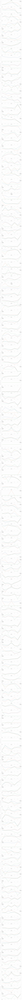

In [53]:
fig, axes = plt.subplots(nrows=len(dicc_jesus_maria), ncols=1, figsize=(15, len(dicc_jesus_maria)*5))
order = 0
for k, v in dicc_jesus_maria.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df,        # data total
        k,         # codigo canilla
        dicc_result_jesus_maria[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1

In [ ]:
"""
fig, axes = plt.subplots(nrows=len(dicc_callao), ncols=1, figsize=(15, len(dicc_callao)*5))
order = 0
for k, v in dicc_callao.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df_21_27,        # data total
        k,         # codigo canilla
        dicc_result_callao[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1
"""

In [ ]:
"""
fig, axes = plt.subplots(nrows=len(dicc_canto_grande), ncols=1, figsize=(15, len(dicc_canto_grande)*5))
order = 0
for k, v in dicc_canto_grande.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df_21_27,        # data total
        k,         # codigo canilla
        dicc_result_canto_grande[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1
"""

In [ ]:
"""
fig, axes = plt.subplots(nrows=len(dicc_olivos), ncols=1, figsize=(15, len(dicc_olivos)*5))
order = 0
for k, v in dicc_olivos.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df_21_27,        # data total
        k,         # codigo canilla
        dicc_result_olivos[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1
"""

In [ ]:
"""
fig, axes = plt.subplots(nrows=len(dicc_lince), ncols=1, figsize=(15, len(dicc_lince)*5))
order = 0
for k, v in dicc_lince.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df_21_27,        # data total
        k,         # codigo canilla
        dicc_result_lince[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1
"""

In [ ]:
"""
fig, axes = plt.subplots(nrows=len(dicc_miraflores), ncols=1, figsize=(15, len(dicc_miraflores)*5))
order = 0
for k, v in dicc_miraflores.items():
    v['table_result'], v['error_int_holt'], v['error_int_winters'] = compare_result(
        df_21_27,        # data total
        k,         # codigo canilla
        dicc_result_miraflores[k],  # diccionario de resultados 
        order,
        axes
    )
    order += 1
"""

# CALLAO

In [ ]:
# print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_callao.items()]))

In [ ]:
# print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_callao.items()]))

### CANTO GRANDE

In [ ]:
# print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_canto_grande.items()]))

In [ ]:
# print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_canto_grande.items()]))

### JESUS MARIA

In [55]:
print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_jesus_maria.items()]))

HOLT 1811


In [56]:
print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_jesus_maria.items()]))

WINTERS 2059


# OLIVOS

In [ ]:
# print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_olivos.items()]))

In [ ]:
# print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_olivos.items()]))

# LINCE

In [ ]:
# print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_lince.items()]))

In [ ]:
# print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_lince.items()]))

# MIRAFLORES

In [ ]:
# print('HOLT', sum([v.get('error_int_holt', 0) for k, v in dicc_miraflores.items()]))

In [ ]:
# print('WINTERS', sum([v.get('error_int_winters', 0) for k, v in dicc_miraflores.items()]))

# GENERANDO REPORTE

In [60]:
def report_result(data, codigo_canilla, dicc_predict, order, name_csv):
    result = sorted(dicc_predict.items(), key=lambda _: _[0])
    
    result = pd.DataFrame(
        data=[_[1].values[0] if isinstance(_[1], pd.Series) else _[1] for _ in result],
        index=[_[0] for _ in result] 
    )
    result.columns = ['Sarimax_bic']
    result['weekday'] = result.index
    
    old_result = pd.DataFrame(
        data[data['CodigoSapCanilla'] == codigo_canilla
            ][['VentaNeta', col_proy, 'weekday', 'Fecha']]['2019-01-21':'2019-01-27']
    )
    result = pd.merge(result, old_result, on='weekday', how='inner')
    result.index = result.Fecha
    result['codigo canilla'] = codigo_canilla
    del result['Fecha']
    del result['weekday']
    
    del old_result
    
    if order == 0:
        result.to_csv(name_csv, header=True)
    else:
        with open(name_csv, 'a') as f:
            result.to_csv(f, header=False)

In [61]:
order = 0
name_csv = 'jesus_maria_bic_sarimax.csv'

for k, v in dicc_jesus_maria.items():
    report_result(
        df,  # data total
        k,         # codigo canilla
        dicc_result_jesus_maria[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1

In [ ]:
"""
order = 0
name_csv = 'callao.csv'

for k, v in dicc_callao.items():
    report_result(
        df_21_27,  # data total
        k,         # codigo canilla
        dicc_result_callao[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1
"""

In [ ]:
"""
order = 0
name_csv = 'canto_grande.csv'

for k, v in dicc_canto_grande.items():
    report_result(
        df_21_27,  # data total
        k,         # codigo canilla
        dicc_result_canto_grande[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1
"""

In [ ]:
"""
order = 0
name_csv = 'lince.csv'

for k, v in dicc_lince.items():
    report_result(
        df_21_27,  # data total
        k,         # codigo canilla
        dicc_result_lince[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1
"""

In [ ]:
"""
order = 0
name_csv = 'olivos.csv'

for k, v in dicc_olivos.items():
    report_result(
        df_21_27,  # data total
        k,         # codigo canilla
        dicc_result_olivos[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1
"""

In [ ]:
"""
order = 0
name_csv = 'miraflores.csv'

for k, v in dicc_miraflores.items():
    report_result(
        df_21_27,  # data total
        k,         # codigo canilla
        dicc_result_miraflores[k],  # diccionario de resultados 
        order,
        name_csv)
    order += 1
"""